In [2]:
import json
import itertools

import matplotlib.pyplot as plt
from matplotlib.cm import ScalarMappable
from matplotlib.colors import Normalize
import pandas as pd
import seaborn as sns

from matplotlib import rcParams
rcParams['figure.figsize'] = 8, 8

In [3]:
with open("results/freeda-vs-zephyrus.json", "r") as f:
    results = json.load(f)

dfs = []
for k, v in results.items():
    x = pd.DataFrame(v).assign(**{
        "solver" : k
    })

    # Add test features
    test_feature = pd.DataFrame(
        x.problem.apply(lambda s : s.split("/")[-1][:-4].split("_")).tolist(),
        columns=["components", "flavours", "nodes", "resources", "comps_topology", "infra_topology", "test"]
    ).assign(**{
        "components" : lambda df : df.components.apply(lambda x : int(x[1:])),
        "flavours": 1, # lambda df : df.flavours.apply(lambda x : int(x[1:])),
        "nodes" : lambda df : df.nodes.apply(lambda x : int(x[1:])),
        "resources" : 1, # lambda df : df.resources.apply(lambda x : int(x[1:])),
        "comps_topology" : lambda df : df.comps_topology.apply(lambda x : x[1:].upper()),
        "infra_topology" : lambda df : df.infra_topology.apply(lambda x : x[1:].upper())
    }).assign(**{
        "problem": x.problem.apply(lambda s : s.split("/")[-2].upper()).tolist(),
    })

    dfs.append(
        pd.merge(
            left=x,
            right=test_feature,
            right_index=True,
            left_index=True,
        ).drop(columns=["problem_x", "objectives"])
    )

df = pd.concat(dfs).rename(columns={"problem_y" : "problem"}).assign(**{
    # Corrections for unkown status codes
    "solve_time" : lambda df : df.apply(
        lambda x :
            300
            if "UNKNOWN" in x["status"]
            else x.solve_time - x.flat_time,
        axis=1)
})

In [4]:
df.query("flat_time > solve_time")

,status,flat_time,solve_time,solver,components,flavours,nodes,resources,comps_topology,infra_topology,test,problem
0,OPTIMAL_SOLUTION,1.449,0.121,chuffed,4,1,3,1,BARABASI,BARABASI,0,FREEDA
1,OPTIMAL_SOLUTION,0.635,0.023,chuffed,4,1,3,1,BARABASI,BARABASI,1,FREEDA
2,OPTIMAL_SOLUTION,0.798,0.025,chuffed,4,1,3,1,BARABASI,BARABASI,2,FREEDA
3,OPTIMAL_SOLUTION,0.713,0.032,chuffed,4,1,3,1,BARABASI,BARABASI,3,FREEDA
4,OPTIMAL_SOLUTION,0.667,0.030,chuffed,4,1,3,1,BARABASI,BARABASI,4,FREEDA
...,...,...,...,...,...,...,...,...,...,...,...,...
19785,OPTIMAL_SOLUTION,1.140,0.427,cpsatlp,14,1,14,1,PATH,WHEEL,0,ZEPHYRUS
19786,OPTIMAL_SOLUTION,1.164,0.316,cpsatlp,14,1,14,1,PATH,WHEEL,1,ZEPHYRUS
19787,OPTIMAL_SOLUTION,1.124,0.600,cpsatlp,14,1,14,1,PATH,WHEEL,2,ZEPHYRUS
19788,OPTIMAL_SOLUTION,1.096,0.339,cpsatlp,14,1,14,1,PATH,WHEEL,3,ZEPHYRUS


In [5]:
df = df[["problem", "components", "flavours", "resources", "nodes", "test", "comps_topology", "infra_topology", "solver", "status", "flat_time", "solve_time"]]

In [6]:
#result_df.to_csv("./results.csv", index=False)

In [7]:
#df = df.query("status != 'UNSATISFIABLE'")

In [8]:
solvers = df.solver.unique()
component_topologies = df.comps_topology.unique()
infrastructure_topologies = df.infra_topology.unique()
alpha = 1.0 / len(df.test.unique())

# DataFrame Analysis

In [9]:
df.status.unique()

array(['OPTIMAL_SOLUTION', 'UNKNOWN'], dtype=object)

In [10]:
df.status.value_counts(normalize=True)

status
OPTIMAL_SOLUTION    0.955268
UNKNOWN             0.044732
Name: proportion, dtype: float64

In [11]:
df[["components", "status"]].groupby("components").value_counts()

components  status          
4           OPTIMAL_SOLUTION    7160
5           OPTIMAL_SOLUTION    7200
6           OPTIMAL_SOLUTION    7192
            UNKNOWN                8
7           OPTIMAL_SOLUTION    7064
            UNKNOWN              136
8           OPTIMAL_SOLUTION    6950
            UNKNOWN              250
9           OPTIMAL_SOLUTION    6883
            UNKNOWN              317
10          OPTIMAL_SOLUTION    6851
            UNKNOWN              349
11          OPTIMAL_SOLUTION    6796
            UNKNOWN              404
12          OPTIMAL_SOLUTION    6621
            UNKNOWN              579
13          OPTIMAL_SOLUTION    6478
            UNKNOWN              722
14          OPTIMAL_SOLUTION    6424
            UNKNOWN              776
Name: count, dtype: int64

In [12]:
df[["nodes", "status"]].groupby("nodes").value_counts()

nodes  status          
3      OPTIMAL_SOLUTION    6301
       UNKNOWN              299
4      OPTIMAL_SOLUTION    6315
       UNKNOWN              285
5      OPTIMAL_SOLUTION    6291
       UNKNOWN              309
6      OPTIMAL_SOLUTION    6318
       UNKNOWN              282
7      OPTIMAL_SOLUTION    6305
       UNKNOWN              295
8      OPTIMAL_SOLUTION    6319
       UNKNOWN              281
9      OPTIMAL_SOLUTION    6244
       UNKNOWN              316
10     OPTIMAL_SOLUTION    6301
       UNKNOWN              299
11     OPTIMAL_SOLUTION    6305
       UNKNOWN              295
12     OPTIMAL_SOLUTION    6289
       UNKNOWN              311
13     OPTIMAL_SOLUTION    6326
       UNKNOWN              274
14     OPTIMAL_SOLUTION    6305
       UNKNOWN              295
Name: count, dtype: int64

In [13]:
pd.concat(
    [
        df[["components", "nodes", "status"]].groupby(["components", "nodes"]).value_counts(),
        df[["components", "nodes", "status"]].groupby(["components", "nodes"]).value_counts(normalize=True) * 100
    ],
    axis=1,
    keys=['counts', '%']
).reset_index()#.to_csv("./status_aggregated.csv", index=False)

,components,nodes,status,counts,%
0,4,3,OPTIMAL_SOLUTION,600,100.000000
1,4,4,OPTIMAL_SOLUTION,600,100.000000
2,4,5,OPTIMAL_SOLUTION,600,100.000000
3,4,6,OPTIMAL_SOLUTION,600,100.000000
4,4,7,OPTIMAL_SOLUTION,600,100.000000
...,...,...,...,...,...
226,14,12,UNKNOWN,62,10.333333
227,14,13,OPTIMAL_SOLUTION,533,88.833333
228,14,13,UNKNOWN,67,11.166667
229,14,14,OPTIMAL_SOLUTION,538,89.666667


<Axes: title={'center': 'Distribution of solve_time'}>

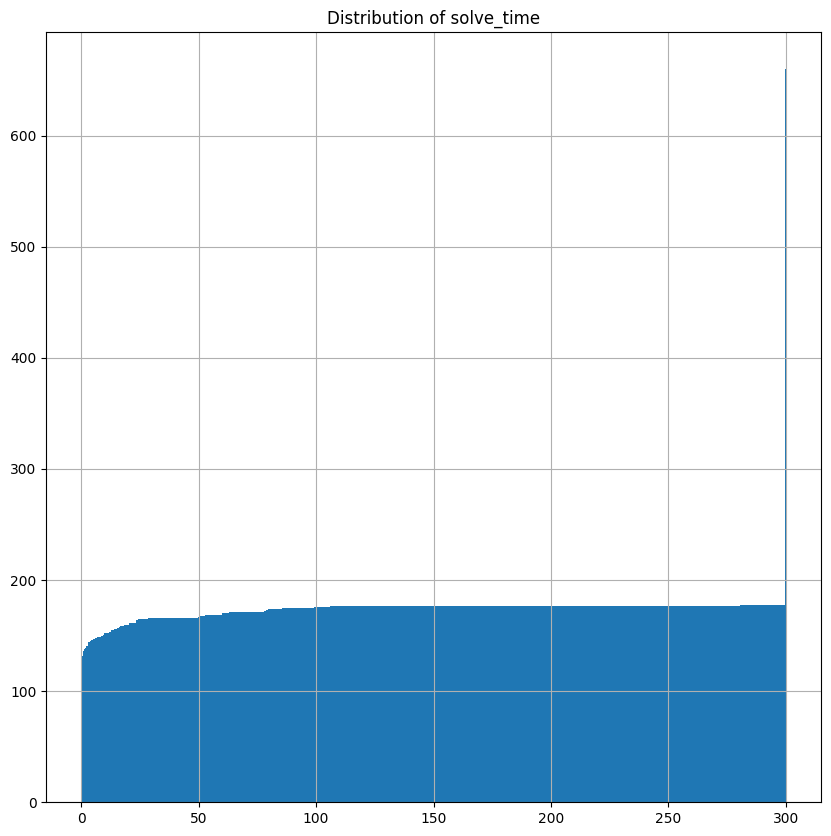

In [14]:
plt.figure(figsize=(10, 10))
plt.title("Distribution of solve_time")
vbs = df.sort_values("solve_time", ascending=False).groupby(["components", "nodes", "test"]).head(1)
vbs.solve_time.sort_values().hist(bins=1000, cumulative=True)

<Axes: title={'center': 'Distribution without Unkowns'}>

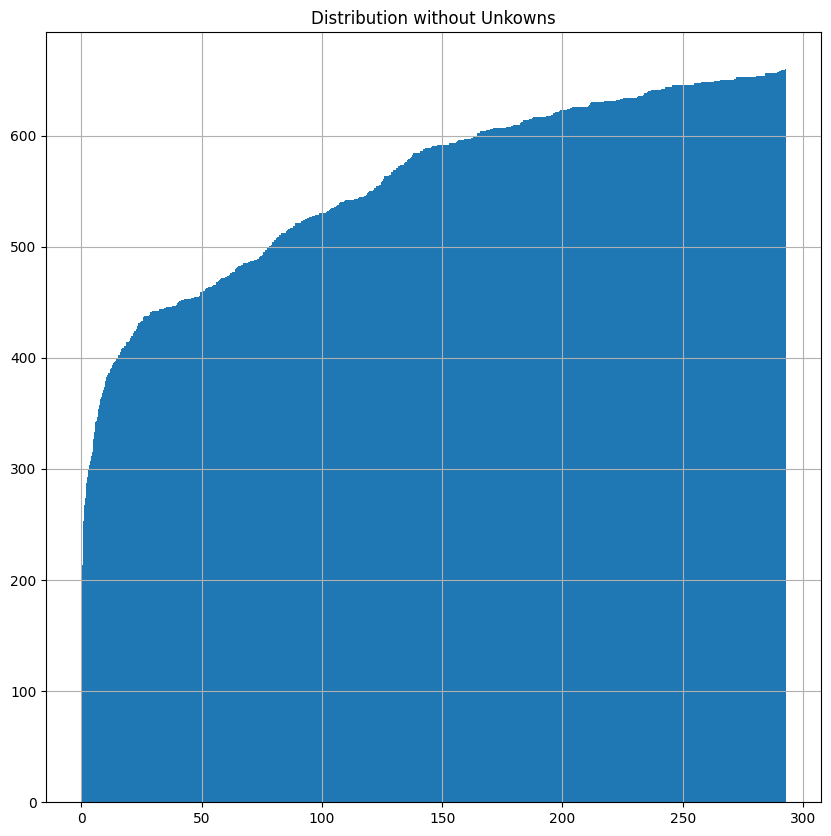

In [15]:
plt.figure(figsize=(10, 10))
plt.title("Distribution without Unkowns")
vbs = df.query("status != 'UNKNOWN'").sort_values("solve_time", ascending=False).groupby(["components", "nodes", "test"]).head(1)
vbs.solve_time.sort_values().hist(bins=1000, cumulative=True)

<Axes: title={'center': 'Distribution without Gecode'}>

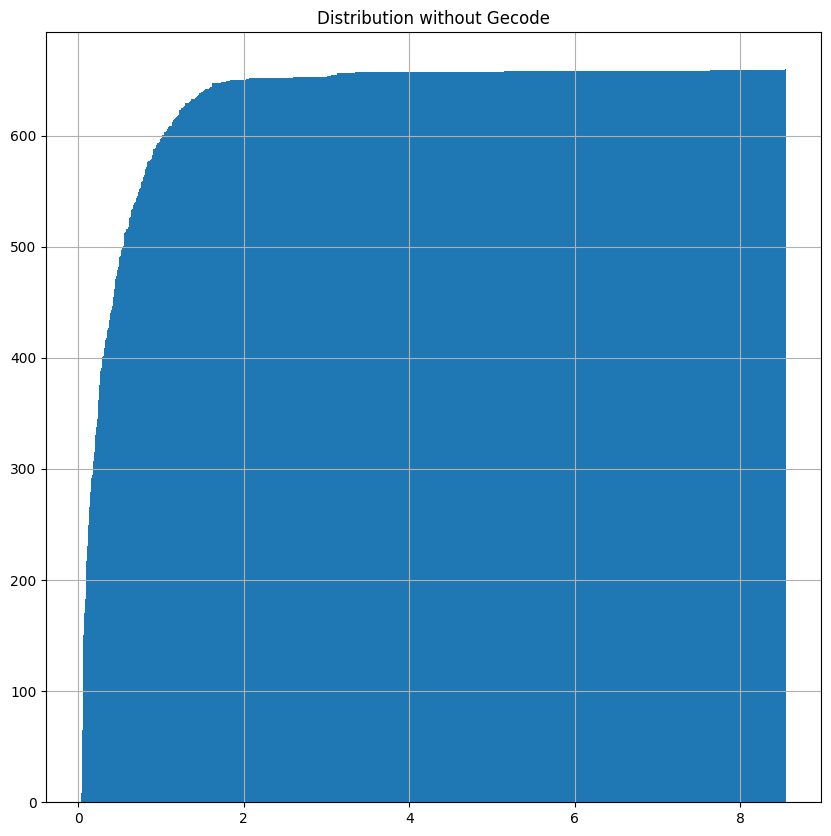

In [16]:
plt.figure(figsize=(10, 10))
plt.title("Distribution without Gecode")
vbs = df.query("solver != 'gecode'").sort_values("solve_time", ascending=False).groupby(["components", "nodes", "test"]).head(1)
vbs.solve_time.sort_values().hist(bins=1000, cumulative=True)

# Solve Time

### Components

In [17]:
problems = df.problem.unique().tolist()

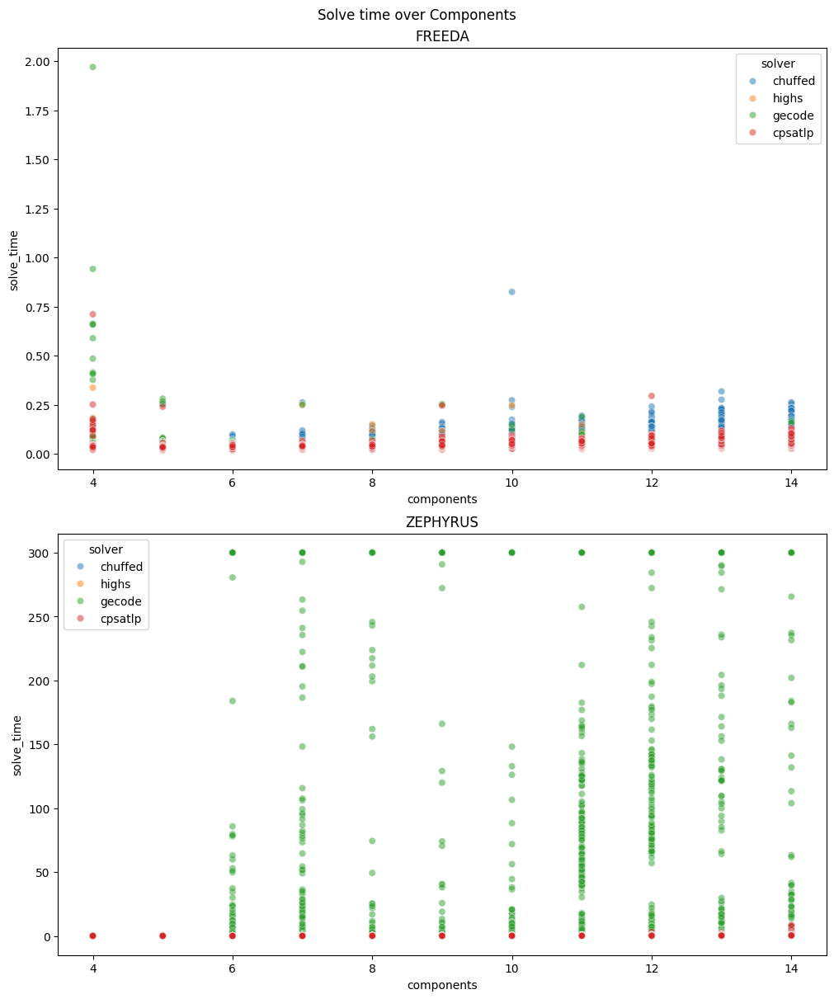

In [18]:
fig, axs = plt.subplots(len(problems), 1, constrained_layout=True)
fig.suptitle("Solve time over Components")
fig.set_figheight(6 * len(problems))
fig.set_figwidth(10)
for p, ax in zip(df.problem.unique(), axs):
    ax.set_title(str(p))
    sns.scatterplot(
        data=df.query("problem == @p"),
        x="components",
        y="solve_time",
        alpha=0.5,
        hue="solver",
        ax=ax
    )

### Nodes

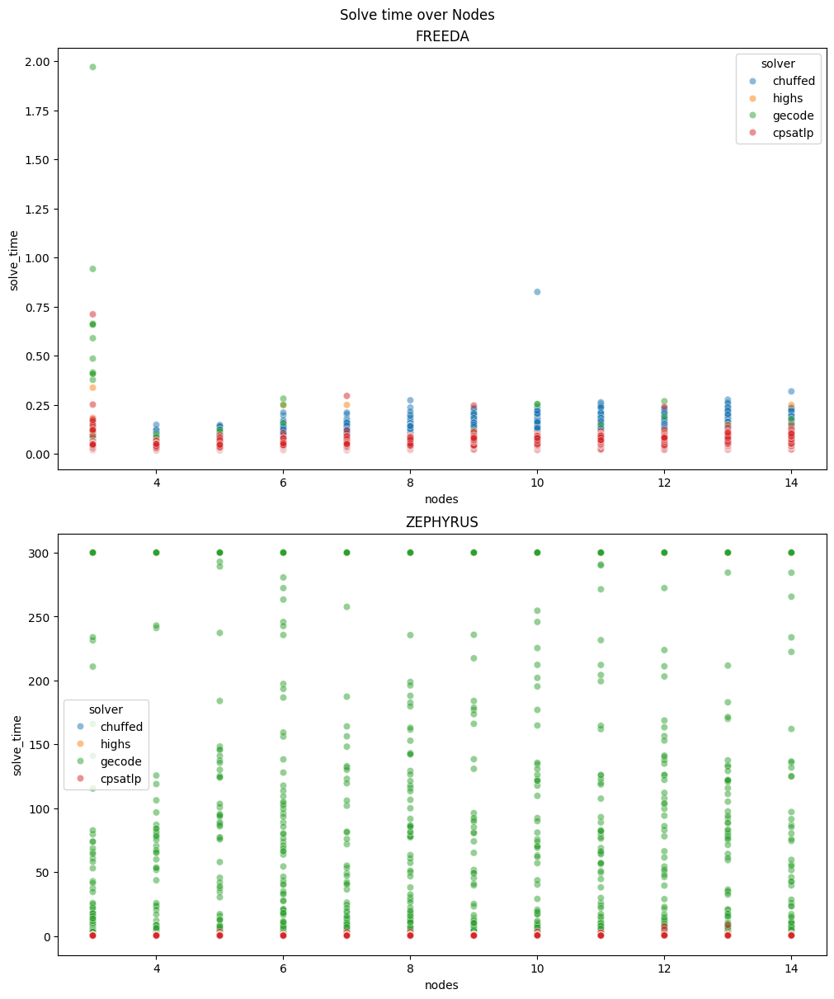

In [19]:
fig, axs = plt.subplots(len(problems), 1, constrained_layout=True)
fig.suptitle("Solve time over Nodes")
fig.set_figheight(6 * len(problems))
fig.set_figwidth(10)
for p, ax in zip(df.problem.unique(), axs):
    ax.set_title(str(p))
    sns.scatterplot(
        data=df.query("problem == @p"),
        x="nodes",
        y="solve_time",
        alpha=0.5,
        hue="solver",
        ax=ax
    )

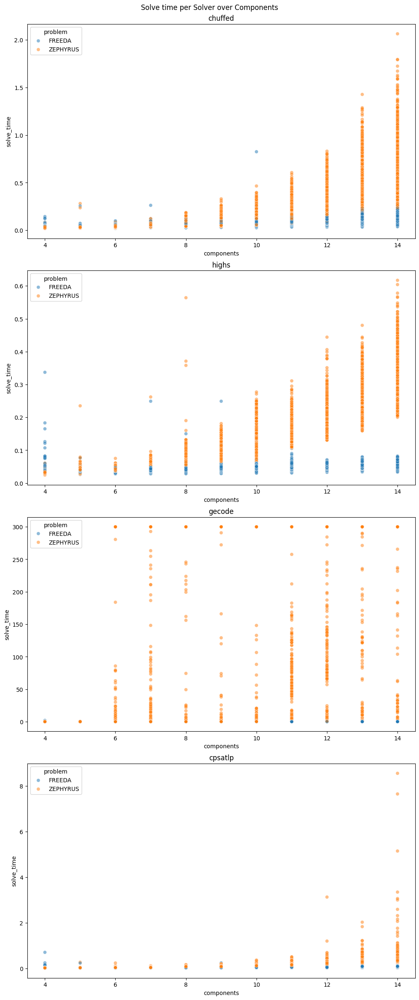

In [20]:
solvers = df.solver.unique()
fig, axs = plt.subplots(len(solvers), 1, constrained_layout=True)
fig.suptitle("Solve time per Solver over Components")
fig.set_figheight(6 * len(solvers))
fig.set_figwidth(10)
for s, ax in zip(solvers, axs):
    ax.set_title(str(s))
    sns.scatterplot(
        data=df.query("solver == @s"),
        x="components",
        y="solve_time",
        alpha=0.5,
        hue="problem",
        ax=ax
    )

### Components x nodes

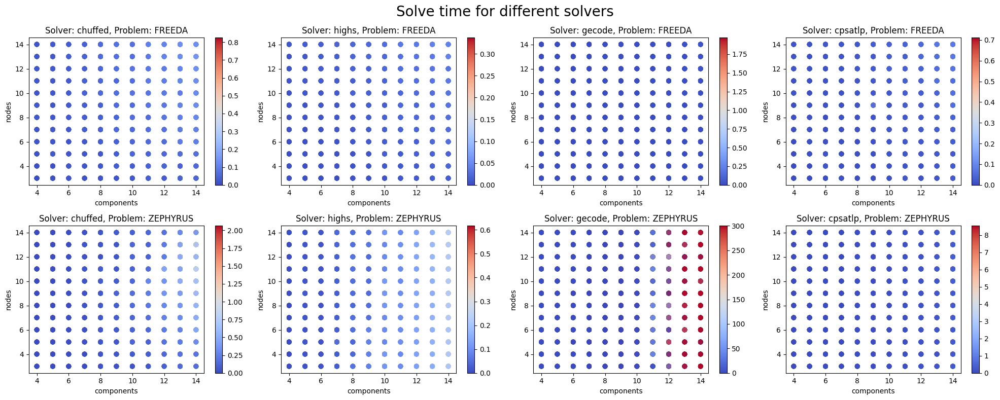

In [21]:
fig, axs = plt.subplots(
    nrows=len(problems),
    ncols=len(solvers),
    figsize=(5 * len(solvers), 4 * len(problems))
)
for p, ax_row in zip(problems, axs):
    for s, ax in zip(solvers, ax_row):
        d = df.query("problem == @p").query("solver == @s")
        norm = Normalize(vmin=0, vmax=d.solve_time.max())
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.solve_time,
            cmap="coolwarm",
            alpha=1.0/len(d.test.unique())
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + s + ", Problem: " + p)
        fig.colorbar(ScalarMappable(norm=norm, cmap="coolwarm"), ax=ax, orientation='vertical')

fig.suptitle("Solve time for different solvers", fontsize=20)
fig.tight_layout()

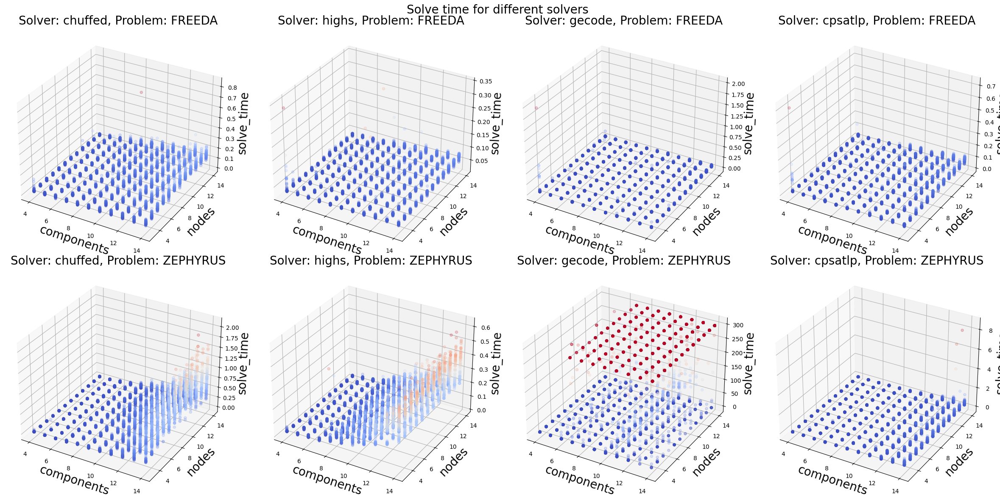

In [22]:
fig, axs = plt.subplots(
    nrows=len(problems),
    ncols=len(solvers),
    figsize=(6 * len(solvers), 6 * len(problems)),
    subplot_kw=dict(projection='3d')
)
for p, ax_row in zip(problems, axs):
    for s, ax in zip(solvers, ax_row):
        d = df.query("problem == @p").query("solver == @s")
        ax.scatter(
            xs=d.components,
            ys=d.nodes,
            zs=d.solve_time,
            c=d.solve_time,
            cmap="coolwarm",
            alpha=1.0/len(d.test.unique())
        )
        ax.set_xlabel("components", fontsize=20)
        ax.set_ylabel("nodes", fontsize=20)
        ax.set_zlabel("solve_time", fontsize=20)
        ax.set_title("Solver: " + s + ", Problem: " + p, fontsize=20)

fig.suptitle("Solve time for different solvers", fontsize=20)
fig.tight_layout()

### Topologies

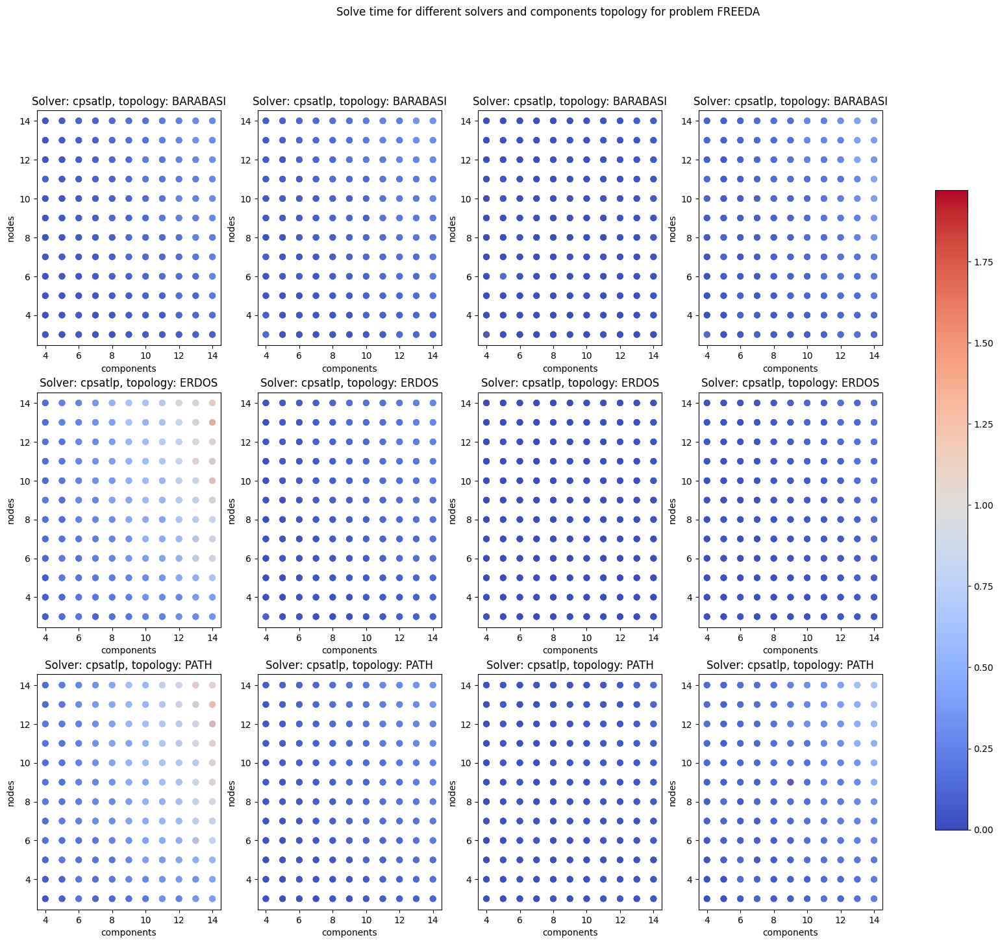

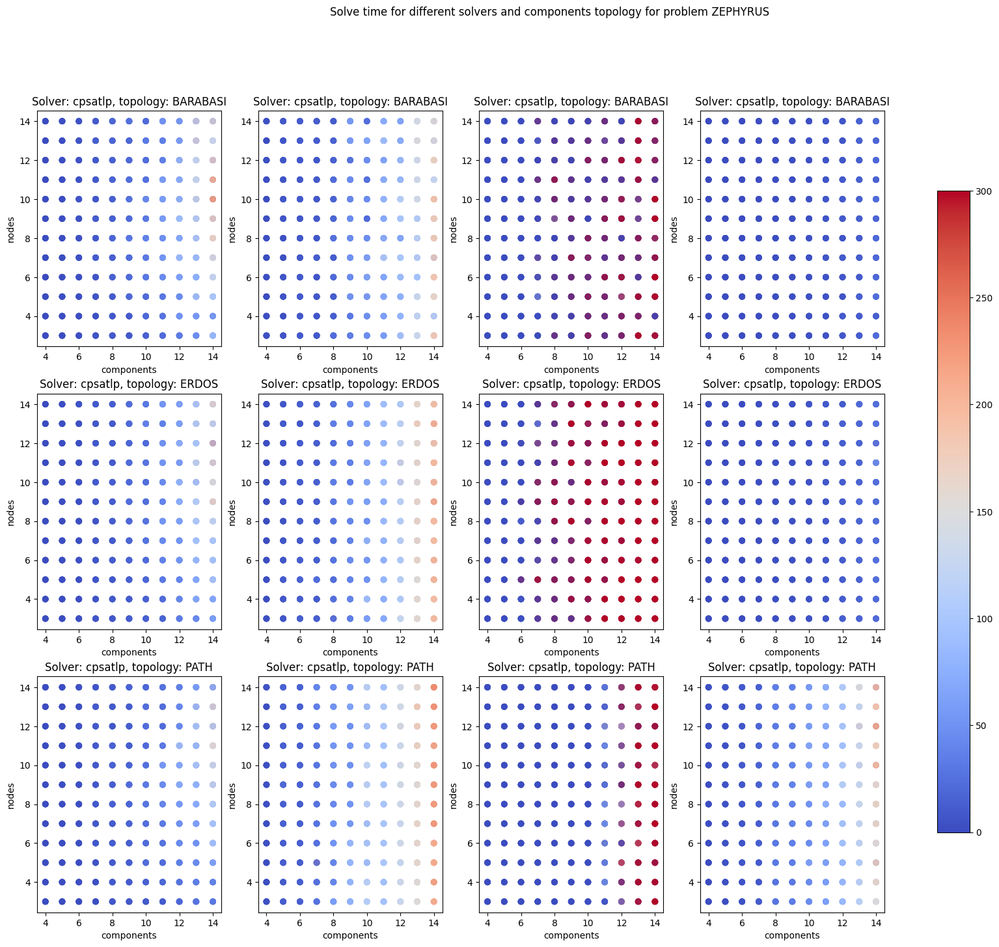

In [23]:
for p in problems:
    fig, axs = plt.subplots(
        nrows=len(component_topologies),
        ncols=len(solvers),
        figsize=(7 * len(component_topologies), 4 * len(solvers))
    )
    axs_reshaped = axs.reshape(-1)
    axis = itertools.product(component_topologies, solvers)
    df_problem = df.query("problem == @p")
    for (topology, solver), ax in zip(axis, axs_reshaped):
        d = df_problem.query("solver == @solver").query("comps_topology == @topology")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.solve_time,
            cmap="coolwarm",
            alpha=1.0/len(d.test.unique())
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + s + ", topology: " + topology)

    norm = Normalize(vmin=0, vmax=df_problem.solve_time.max())
    fig.suptitle("Solve time for different solvers and components topology for problem " + p)
    fig.colorbar(
        ScalarMappable(norm=norm, cmap="coolwarm"),
        ax=axs.ravel().tolist(),
        orientation='vertical',
        shrink=0.8
    )

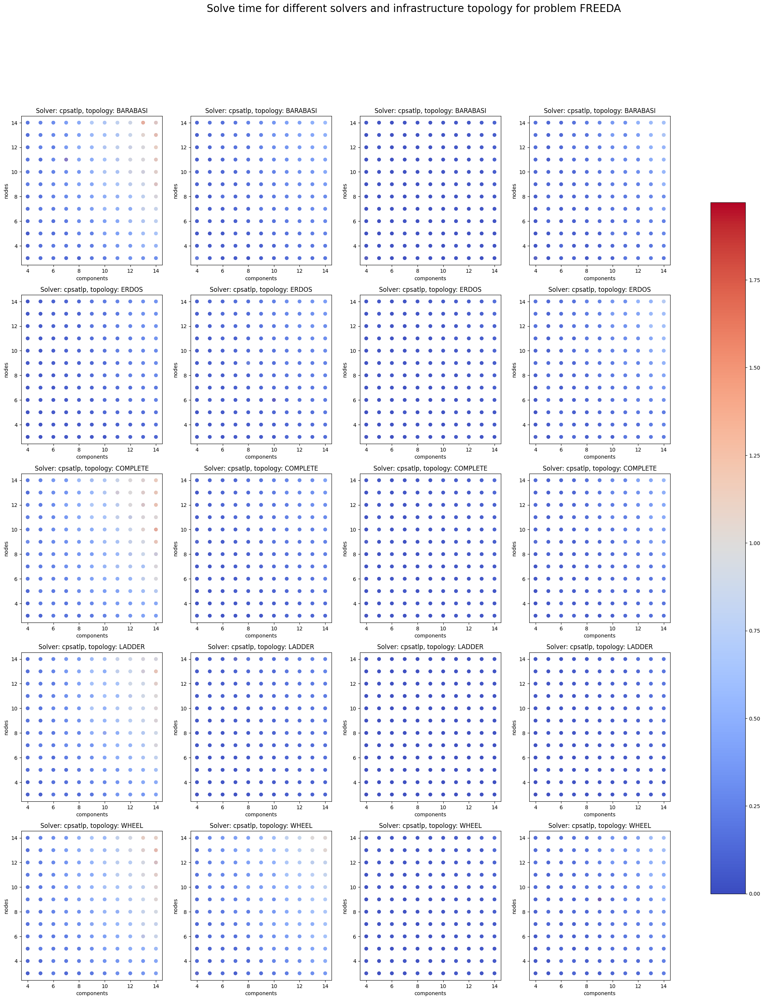

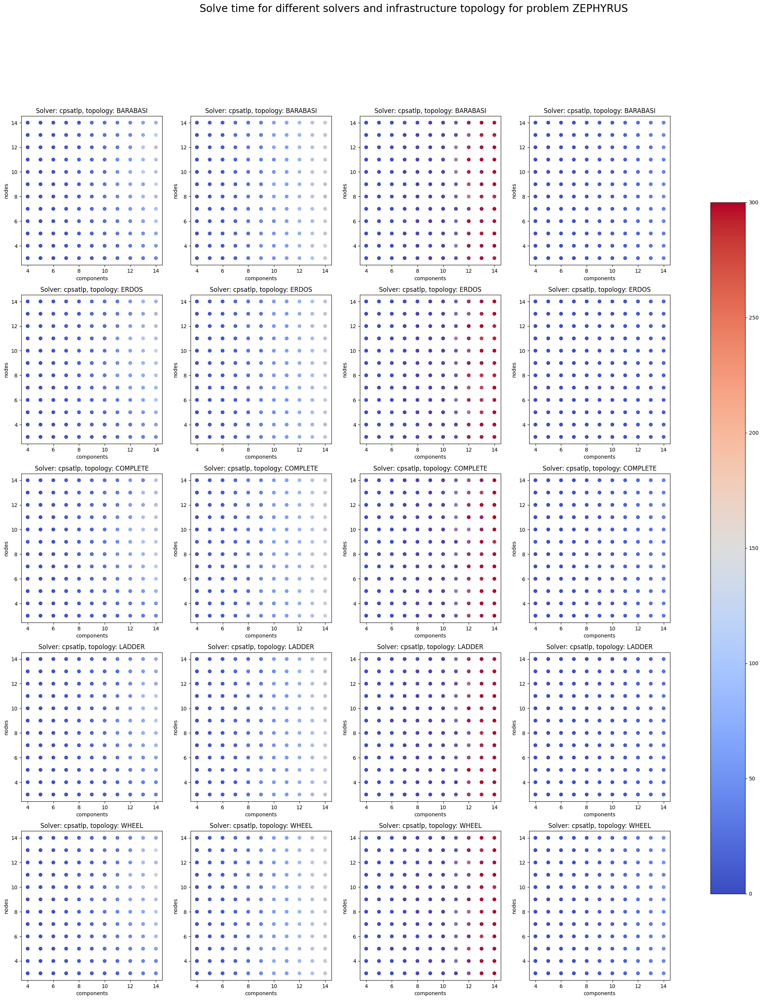

In [24]:
for p in problems:
    fig, axs = plt.subplots(
        nrows=len(infrastructure_topologies),
        ncols=len(solvers),
        figsize=(7 * len(solvers), 6 * len(infrastructure_topologies))
    )
    axs_reshaped = axs.reshape(-1)
    axis = itertools.product(infrastructure_topologies, solvers)
    df_problem = df.query("problem == @p")
    for (topology, solver), ax in zip(axis, axs_reshaped):
        d = df_problem.query("solver == @solver").query("infra_topology == @topology")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.solve_time,
            cmap="coolwarm",
            alpha=1.0/len(d.test.unique())
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + s + ", topology: " + topology)

    norm = Normalize(vmin=0, vmax=df_problem.solve_time.max())
    fig.colorbar(
        ScalarMappable(norm=norm, cmap="coolwarm"),
        ax=axs.ravel().tolist(),
        orientation='vertical',
        shrink=0.8
    )
    fig.suptitle("Solve time for different solvers and infrastructure topology for problem " + p, fontsize=20)

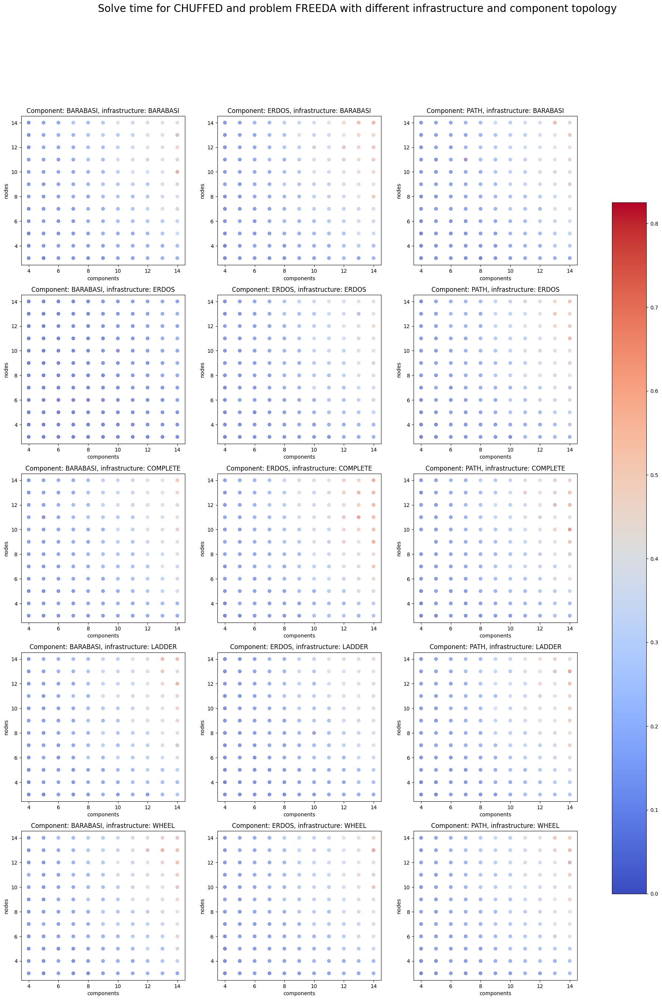

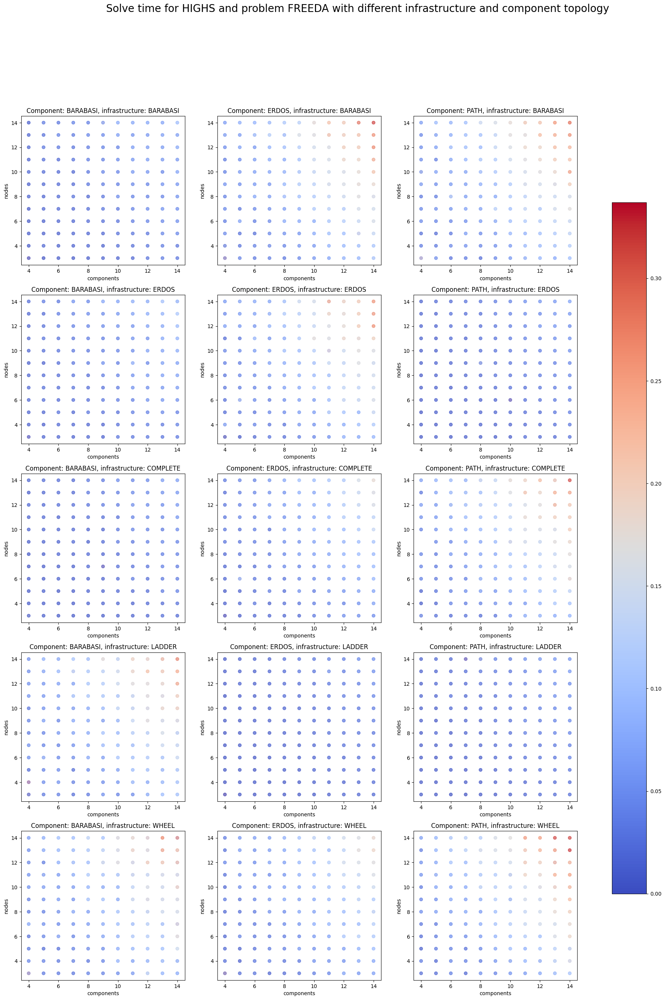

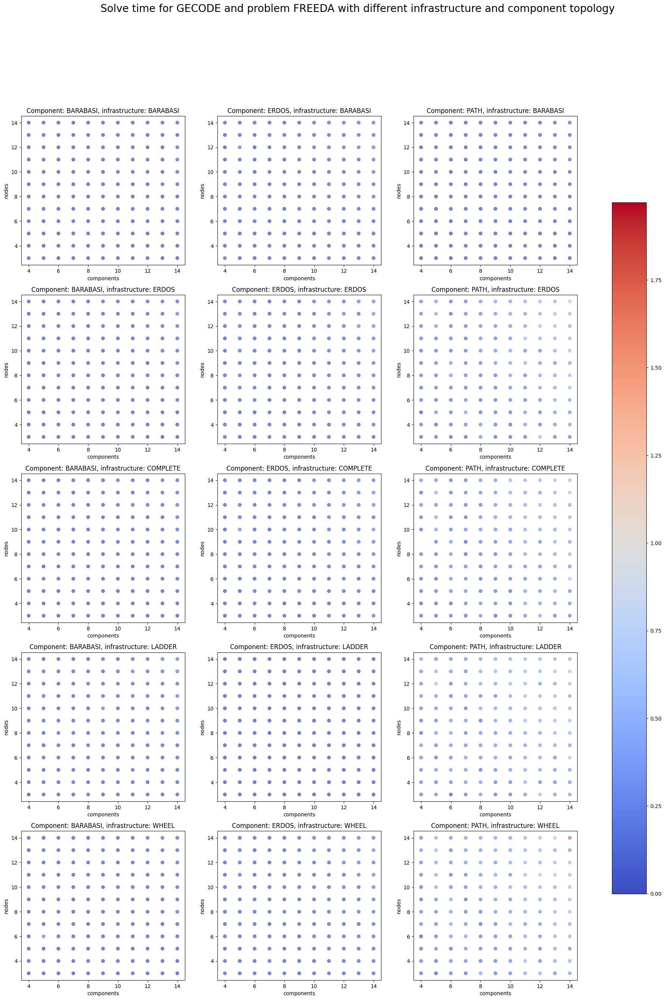

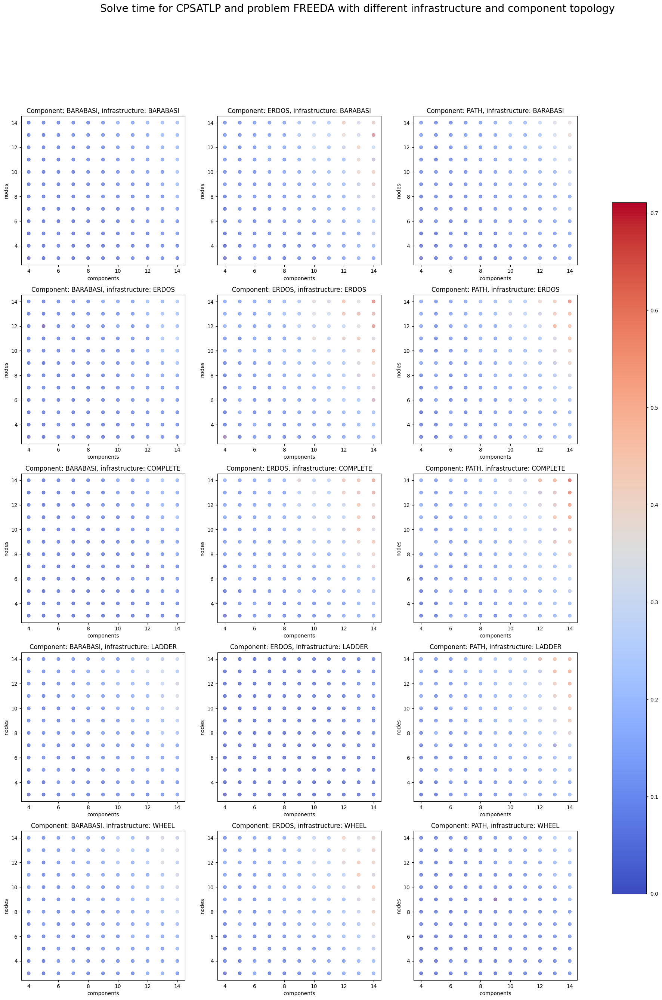

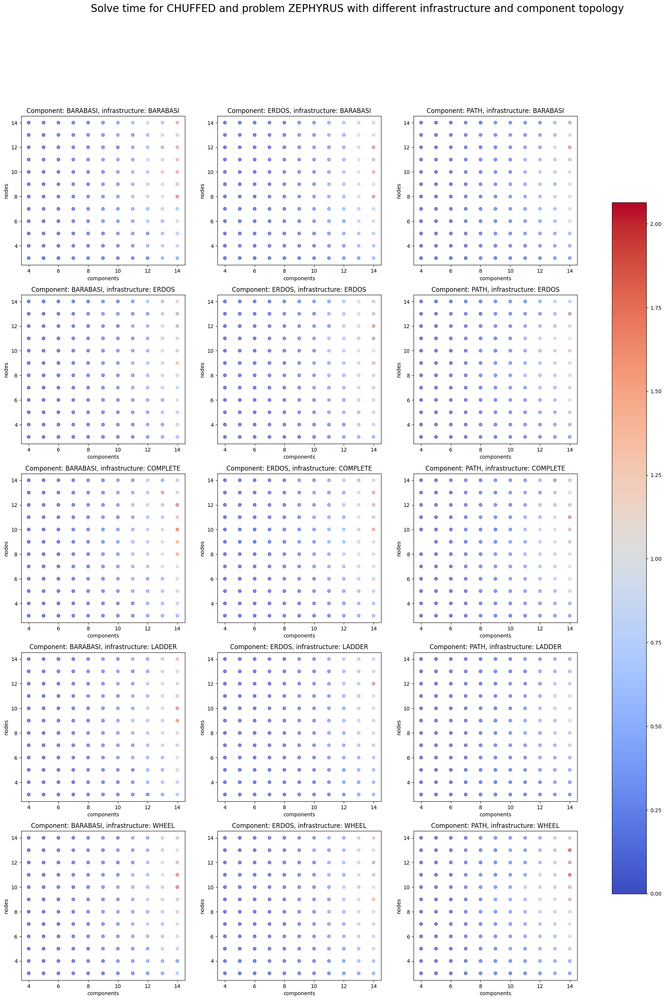

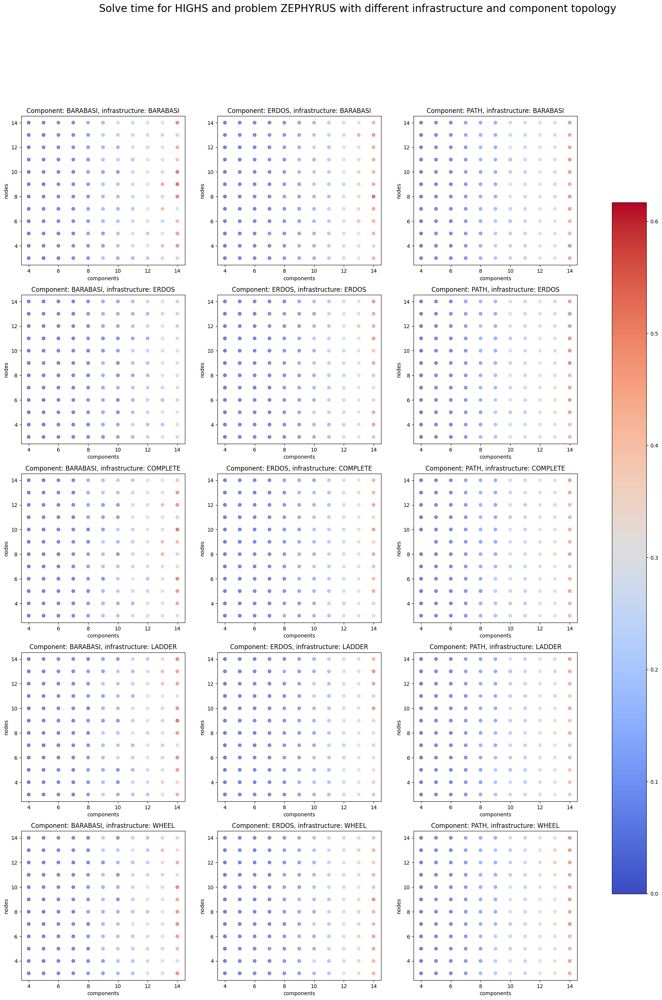

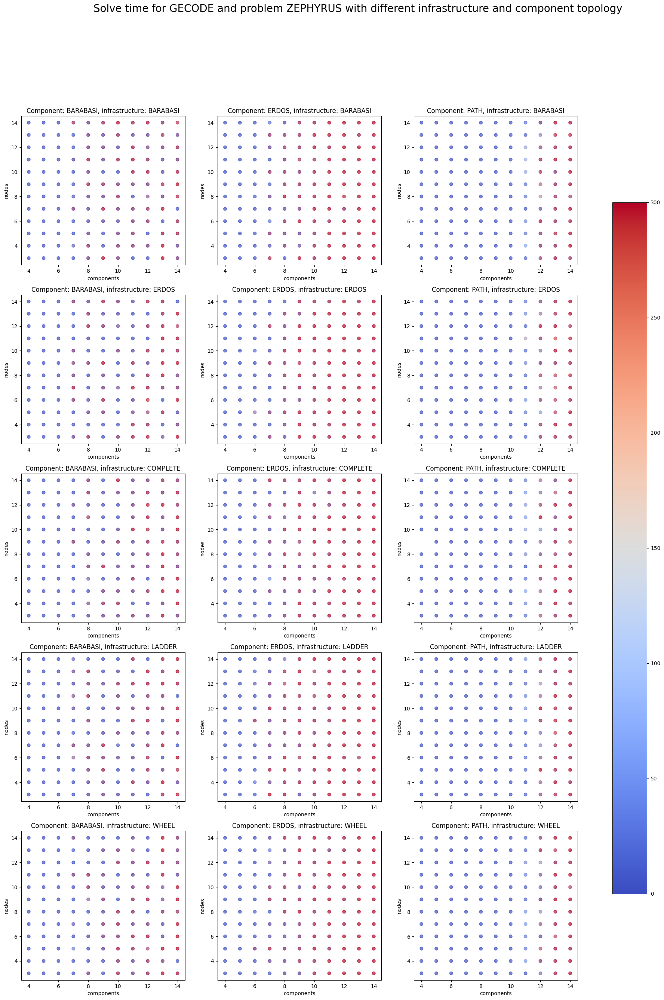

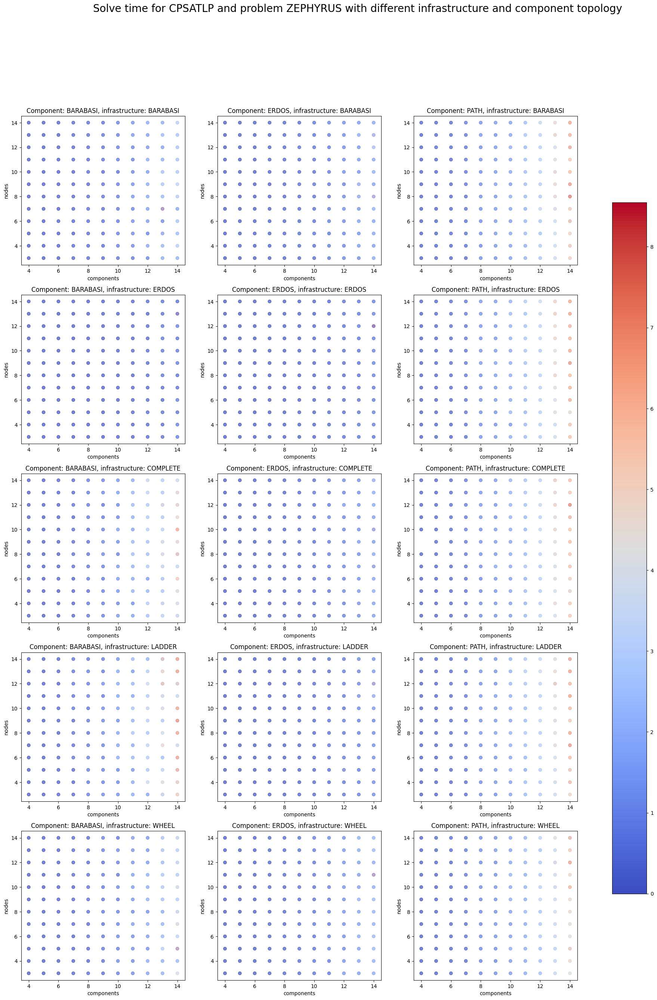

In [25]:
for p in problems:
    for solver in solvers:
        fig, axs = plt.subplots(
            nrows=len(infrastructure_topologies),
            ncols=len(component_topologies),
            figsize=(8 * len(component_topologies), 6 * len(infrastructure_topologies))
        )
        axs_reshaped = axs.reshape(-1)
        axis = itertools.product(infrastructure_topologies, component_topologies)
        df_solver_problem = df.query("problem == @p").query("solver == @solver")
        for (infra_topology, comps_topology), ax in zip(axis, axs_reshaped):
            d = df_solver_problem.query("infra_topology == @infra_topology").query("comps_topology == @comps_topology")
            ax.scatter(
                x=d.components,
                y=d.nodes,
                c=d.solve_time,
                cmap="coolwarm",
                alpha=1.0/len(d.test.unique())
            )
            ax.set_xlabel("components")
            ax.set_ylabel("nodes")
            ax.set_title("Component: " + comps_topology + ", infrastructure: " + infra_topology)

        norm = Normalize(vmin=0, vmax=df_solver_problem.solve_time.max())
        fig.colorbar(
            ScalarMappable(norm=norm, cmap="coolwarm"),
            ax=axs.ravel().tolist(),
            orientation='vertical',
            shrink=0.8
        )
        fig.suptitle("Solve time for " + solver.upper() + " and problem " + p + " with different infrastructure and component topology", fontsize=20)


### Score

In [177]:
def borda_count(x):
    problem1 = x.iloc[0]
    problem2 = x.iloc[1]
    if problem1.status == "UNKNOWN":
        return (0, 1) if problem1.status != problem2.status else (0.5, 0.5)
    else: # problem1.status == "UNSATISFIABLE" or problem1.status == "OPTIMAL_SOLUTION"
        return (1, 0) if problem2.status == "UNKNOWN" else (
            problem2.solve_time / (problem1.solve_time + problem2.solve_time),
            problem1.solve_time / (problem1.solve_time + problem2.solve_time),
        )

df_scores = []
for s in solvers:
    to_score = (df.query("solver == @s")
        .drop(columns=["solver", "flavours", "resources", "solver", "flat_time"])
        .groupby(["components", "nodes", "comps_topology", "infra_topology", "test"])
    )

    scores = pd.concat([
        group.reset_index().assign(**{"score" : lambda df : borda_count(df)})
        for _, group in to_score
    ]).drop(columns=["index", "solve_time", "status"]).reset_index(drop=True)

    df_scores.append(
        scores
        .drop(columns=list(set(scores.columns) - {"problem", "score"}))
        .groupby("problem")
        .sum()
        .assign(solver=s)
    )

df_scores = pd.concat(df_scores).reset_index()[["problem", "solver", "score"]]

In [178]:
df_scores

,problem,solver,score
0,FREEDA,chuffed,6067.021131
1,ZEPHYRUS,chuffed,3827.978869
2,FREEDA,highs,6703.042916
3,ZEPHYRUS,highs,3191.957084
4,FREEDA,gecode,7745.779329
5,ZEPHYRUS,gecode,2149.220671
6,FREEDA,cpsatlp,7026.443238
7,ZEPHYRUS,cpsatlp,2868.556762


In [179]:
df_score_diff = []
for s in solvers:
    to_score = (df.query("solver == @s")
        .drop(columns=["solver", "flavours", "resources", "solver", "flat_time"])
        .groupby(["components", "nodes", "comps_topology", "infra_topology", "test"])
    )

    scores = pd.concat([
        group.reset_index().assign(**{"score" : lambda df : borda_count(df)})
        for _, group in to_score
    ]).drop(columns=["index", "solve_time", "status"]).reset_index(drop=True)

    df_score_diff.append(scores.assign(solver=s))

df_score_diff = pd.concat(df_score_diff).reset_index(drop=True)
df_score_diff = (
    df_score_diff.drop(columns=["problem", "score"])
    .drop_duplicates()
    .reset_index(drop=True)
    .assign(score =
        df_score_diff.query("problem == 'FREEDA'").score.reset_index(drop=True)
        -
        df_score_diff.query("problem == 'ZEPHYRUS'").score.reset_index(drop=True)
    )
)

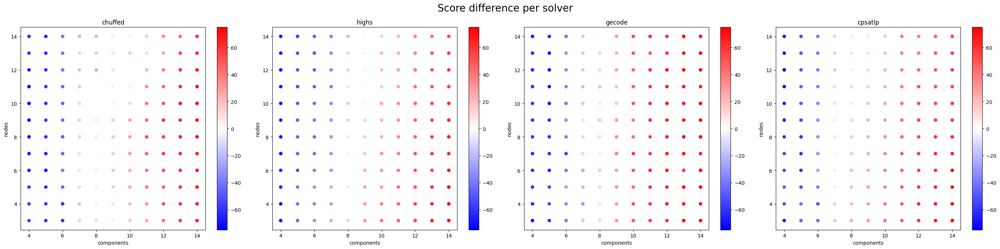

In [180]:
fig, axs = plt.subplots(
    nrows=1,
    ncols=len(solvers),
    figsize=(7 * len(solvers), 7)
)
axs_reshaped = axs.reshape(-1)
max_score = len(df.comps_topology.unique()) * len(df.infra_topology.unique()) * len(df.test.unique())
for solver, ax in zip(solvers, axs_reshaped):
    d = df_score_diff.groupby(["solver", "components", "nodes"]).aggregate({"score": "sum"}).reset_index().query("solver == @solver")
    norm = Normalize(vmin=-max_score, vmax=max_score)
    ax.scatter(
        x=d.components,
        y=d.nodes,
        c=d.score,
        cmap="bwr"
    )
    ax.set_xlabel("components")
    ax.set_ylabel("nodes")
    ax.set_title(solver)
    fig.colorbar(ScalarMappable(norm=norm, cmap="bwr"), ax=ax, orientation='vertical')

fig.suptitle("Score difference per solver", fontsize=20)
fig.tight_layout()

# ROSSO DOVE VINCIAMO, BLU DOVE PERDIAMO

# Flat time

### Components

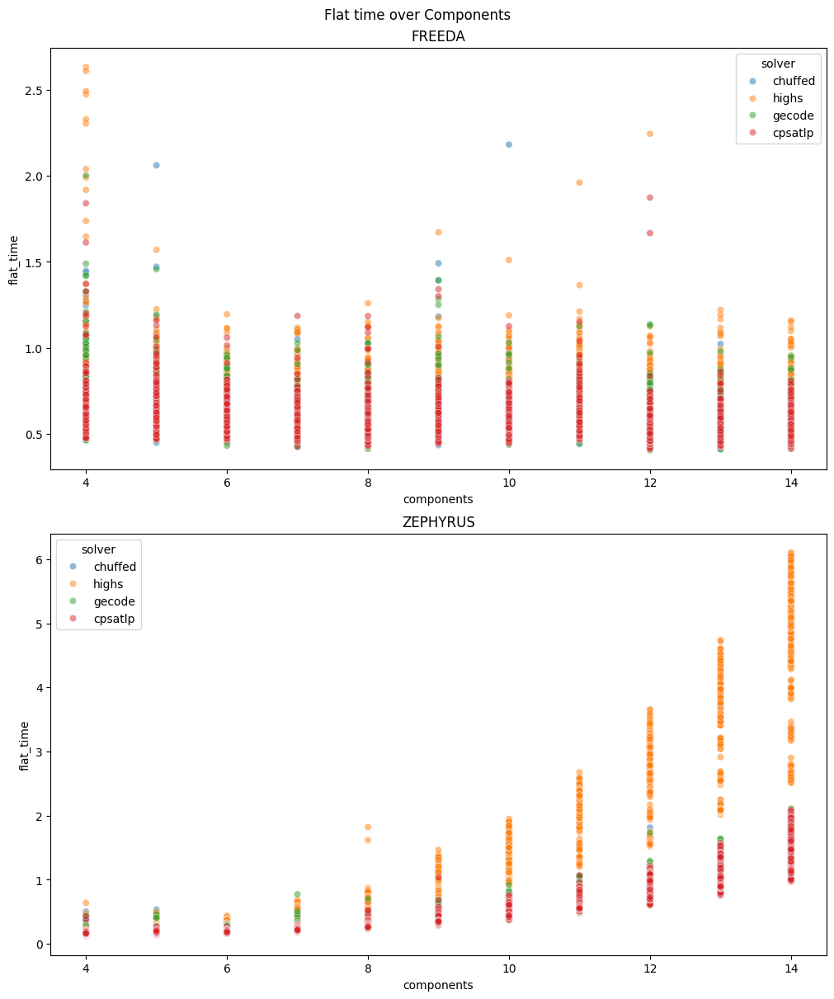

In [26]:
fig, axs = plt.subplots(len(problems), 1, constrained_layout=True)
fig.suptitle("Flat time over Components")
fig.set_figheight(6 * len(problems))
fig.set_figwidth(10)
for p, ax in zip(df.problem.unique(), axs):
    ax.set_title(str(p))
    sns.scatterplot(
        data=df.query("problem == @p"),
        x="components",
        y="flat_time",
        alpha=0.5,
        hue="solver",
        ax=ax
    )

### Nodes

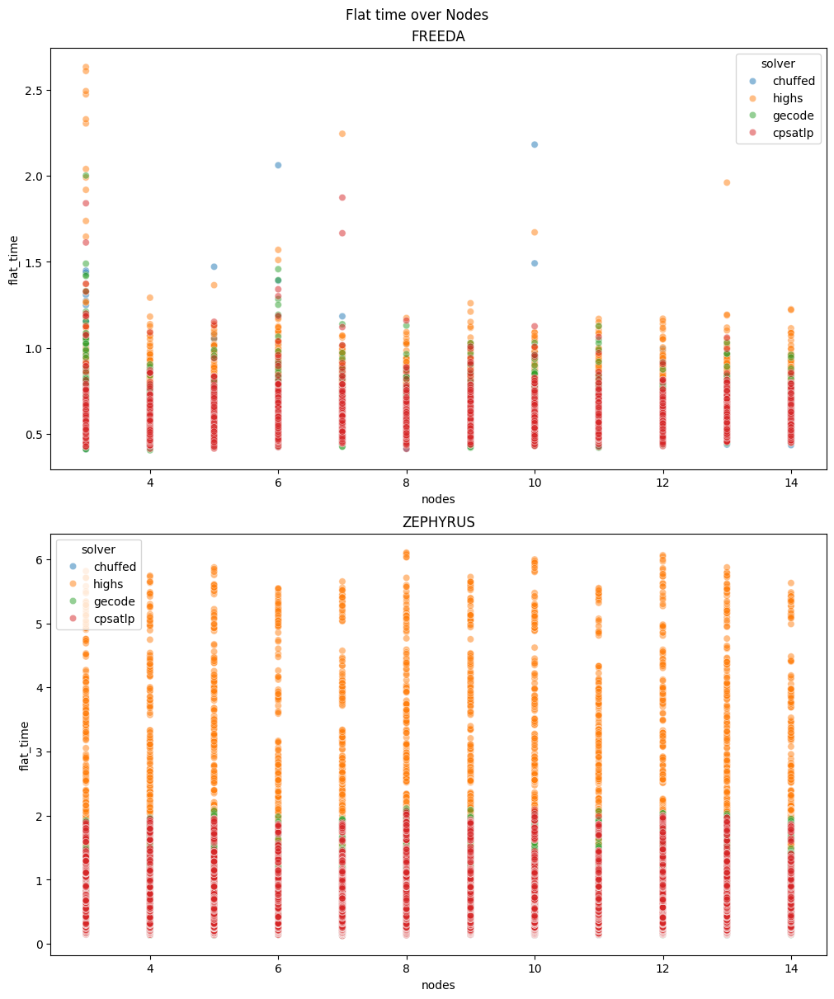

In [27]:
fig, axs = plt.subplots(len(problems), 1, constrained_layout=True)
fig.suptitle("Flat time over Nodes")
fig.set_figheight(6 * len(problems))
fig.set_figwidth(10)
for p, ax in zip(df.problem.unique(), axs):
    ax.set_title(str(p))
    sns.scatterplot(
        data=df.query("problem == @p"),
        x="nodes",
        y="flat_time",
        alpha=0.5,
        hue="solver",
        ax=ax
    )

### Components x nodes

Text(0.5, 0.98, 'Flat time for different solvers')

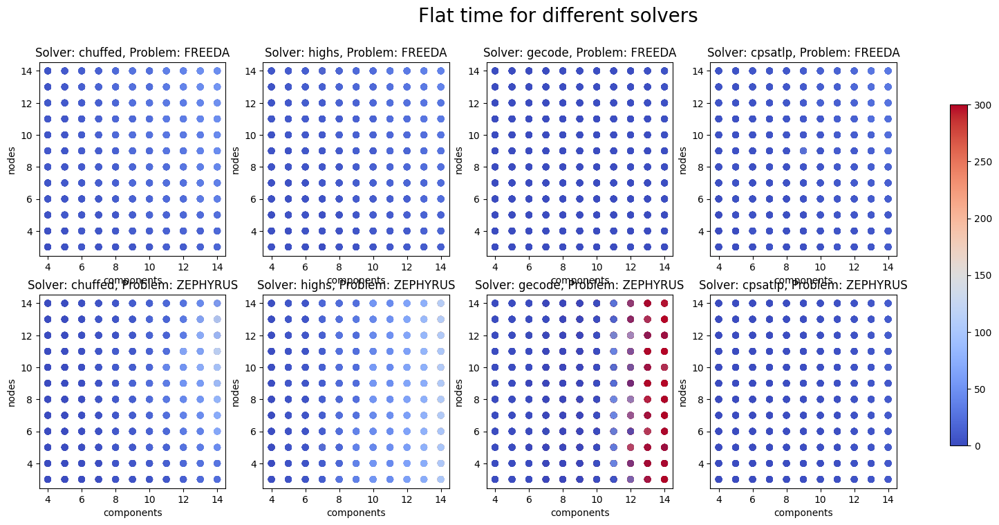

In [28]:
fig, axs = plt.subplots(
    nrows=len(problems),
    ncols=len(solvers),
    figsize=(5 * len(solvers), 4 * len(problems))
)
for p, ax_row in zip(problems, axs):
    for s, ax in zip(solvers, ax_row):
        d = df.query("problem == @p").query("solver == @s")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.solve_time,
            cmap="coolwarm",
            alpha=1.0/len(d.test.unique())
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + s + ", Problem: " + p)

norm = Normalize(vmin=0, vmax=df.solve_time.max())
fig.colorbar(
    ScalarMappable(norm=norm, cmap="coolwarm"),
    ax=axs.ravel().tolist(),
    orientation='vertical',
    shrink=0.8
)
fig.suptitle("Flat time for different solvers", fontsize=20)


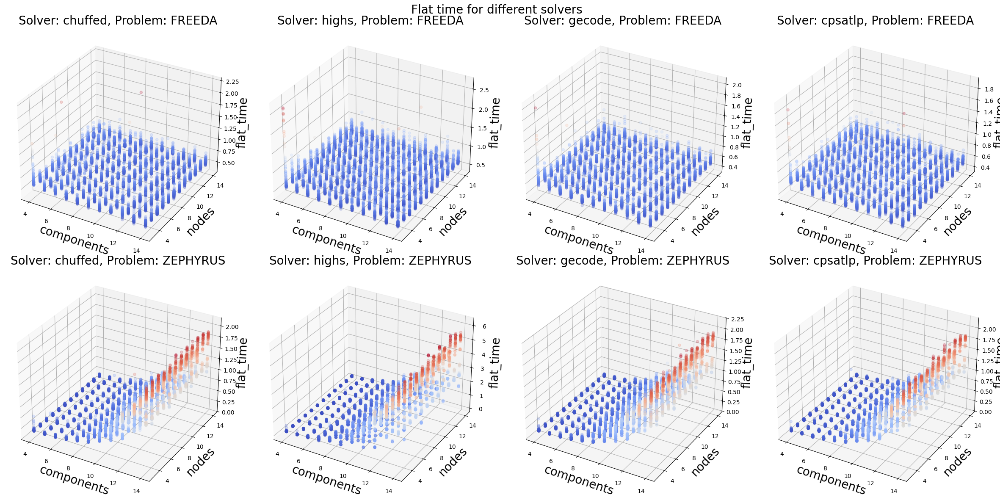

In [29]:
fig, axs = plt.subplots(
    nrows=len(problems),
    ncols=len(solvers),
    figsize=(6 * len(solvers), 6 * len(problems)),
    subplot_kw=dict(projection='3d')
)
for p, ax_row in zip(problems, axs):
    for s, ax in zip(solvers, ax_row):
        d = df.query("problem == @p").query("solver == @s")
        ax.scatter(
            xs=d.components,
            ys=d.nodes,
            zs=d.flat_time,
            c=d.flat_time,
            cmap="coolwarm",
            alpha=1.0/len(d.test.unique())
        )
        ax.set_xlabel("components", fontsize=20)
        ax.set_ylabel("nodes", fontsize=20)
        ax.set_zlabel("flat_time", fontsize=20)
        ax.set_title("Solver: " + s + ", Problem: " + p, fontsize=20)

fig.suptitle("Flat time for different solvers", fontsize=20)
fig.tight_layout()

### Topologies

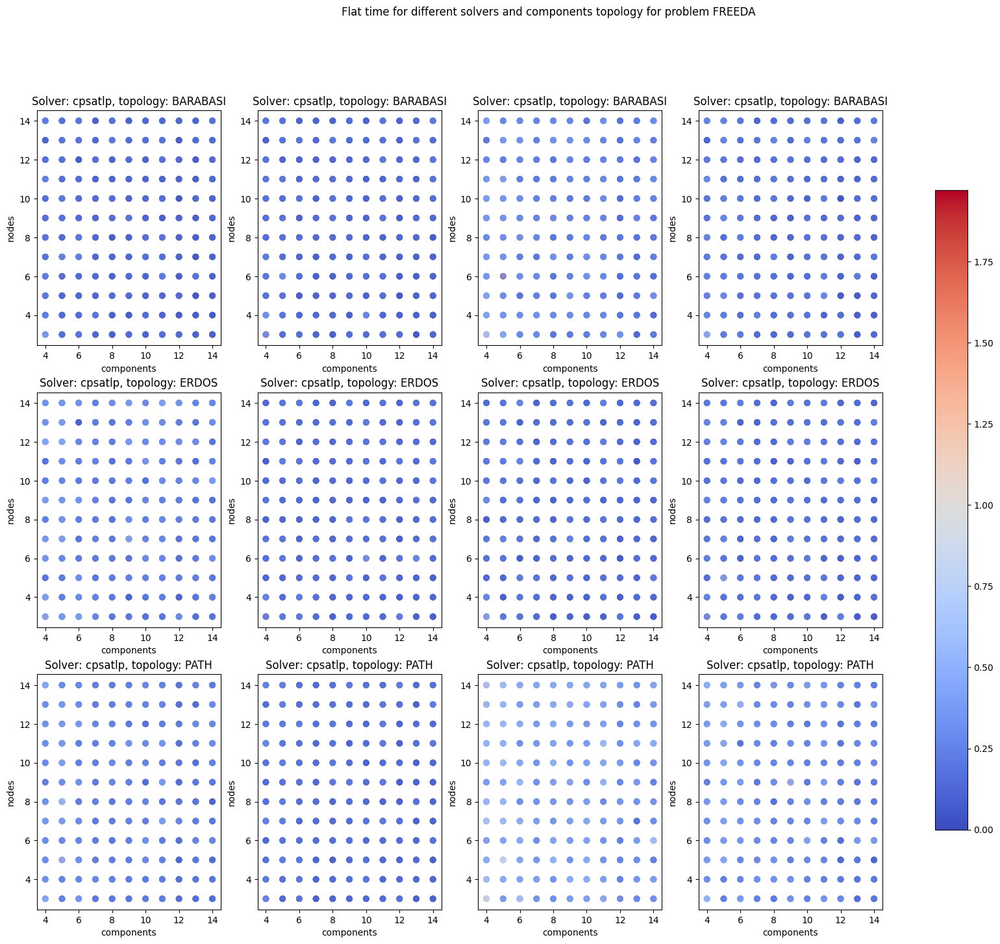

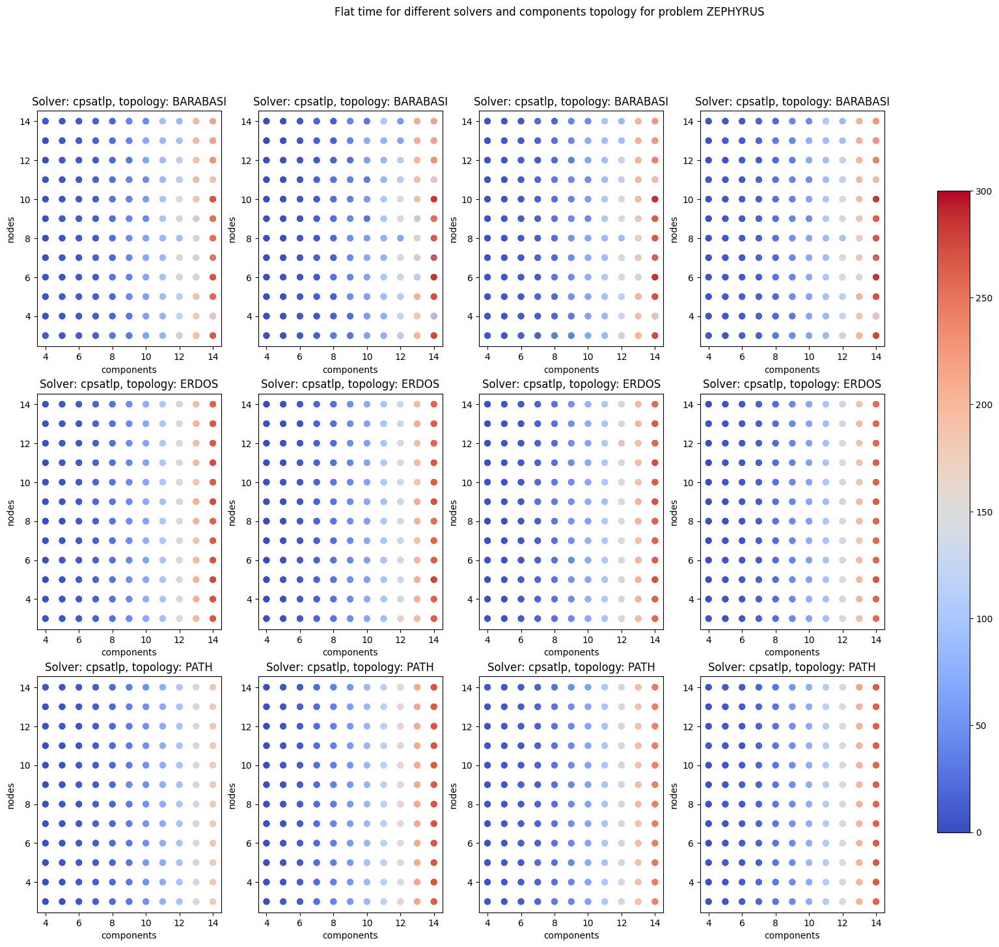

In [30]:
for p in problems:
    fig, axs = plt.subplots(
        nrows=len(component_topologies),
        ncols=len(solvers),
        figsize=(7 * len(component_topologies), 4 * len(solvers))
    )
    axs_reshaped = axs.reshape(-1)
    axis = itertools.product(component_topologies, solvers)
    df_problem = df.query("problem == @p")
    for (topology, solver), ax in zip(axis, axs_reshaped):
        d = df_problem.query("solver == @solver").query("comps_topology == @topology")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.flat_time,
            cmap="coolwarm",
            alpha=1.0/len(d.test.unique())
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + s + ", topology: " + topology)

    norm = Normalize(vmin=0, vmax=df_problem.solve_time.max())
    fig.suptitle("Flat time for different solvers and components topology for problem " + p)
    fig.colorbar(
        ScalarMappable(norm=norm, cmap="coolwarm"),
        ax=axs.ravel().tolist(),
        orientation='vertical',
        shrink=0.8
    )

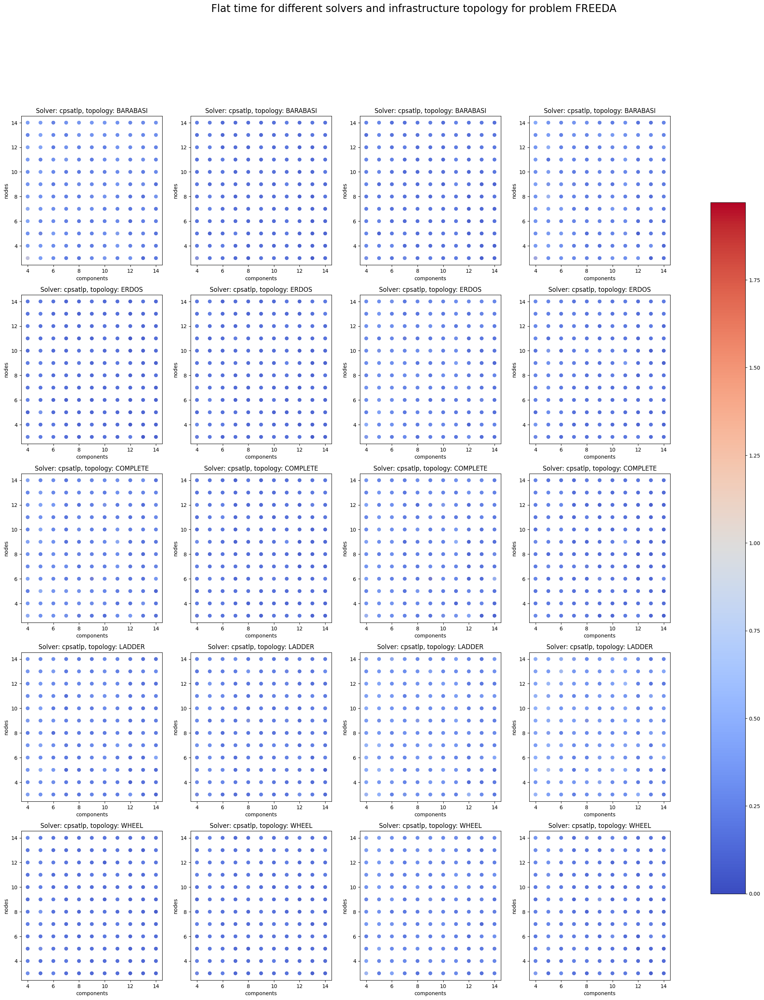

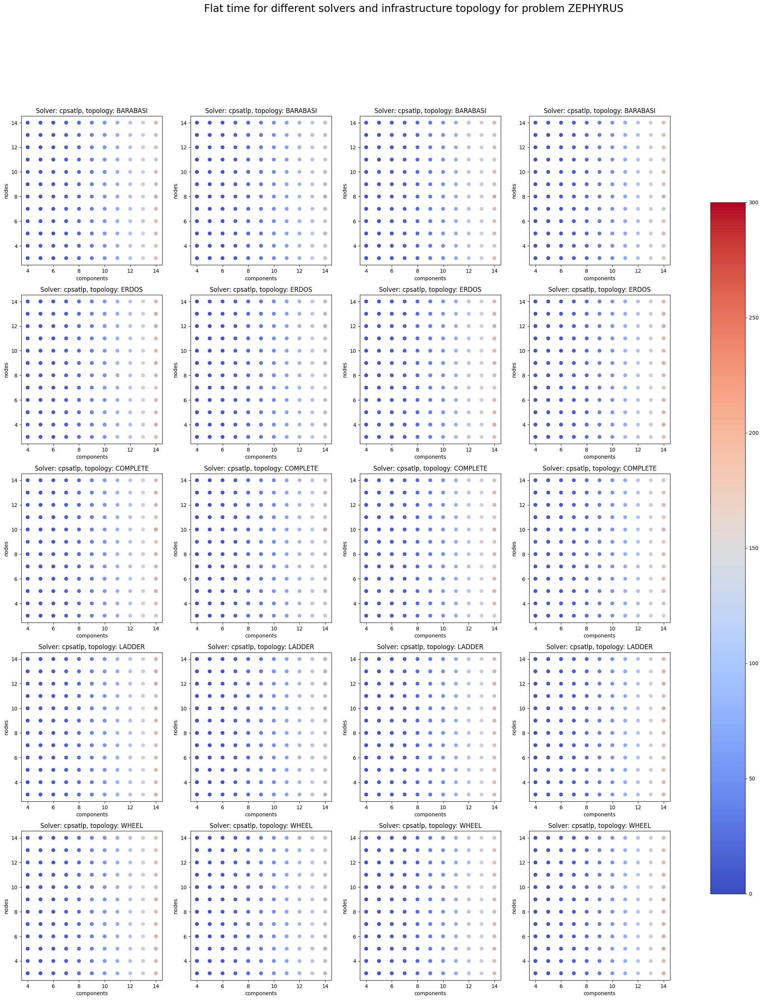

In [31]:
for p in problems:
    fig, axs = plt.subplots(
        nrows=len(infrastructure_topologies),
        ncols=len(solvers),
        figsize=(7 * len(solvers), 6 * len(infrastructure_topologies))
    )
    axs_reshaped = axs.reshape(-1)
    axis = itertools.product(infrastructure_topologies, solvers)
    df_problem = df.query("problem == @p")
    for (topology, solver), ax in zip(axis, axs_reshaped):
        d = df_problem.query("solver == @solver").query("infra_topology == @topology")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.flat_time,
            cmap="coolwarm",
            alpha=1.0/len(d.test.unique())
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + s + ", topology: " + topology)

    norm = Normalize(vmin=0, vmax=df_problem.solve_time.max())
    fig.colorbar(
        ScalarMappable(norm=norm, cmap="coolwarm"),
        ax=axs.ravel().tolist(),
        orientation='vertical',
        shrink=0.8
    )
    fig.suptitle("Flat time for different solvers and infrastructure topology for problem " + p, fontsize=20)

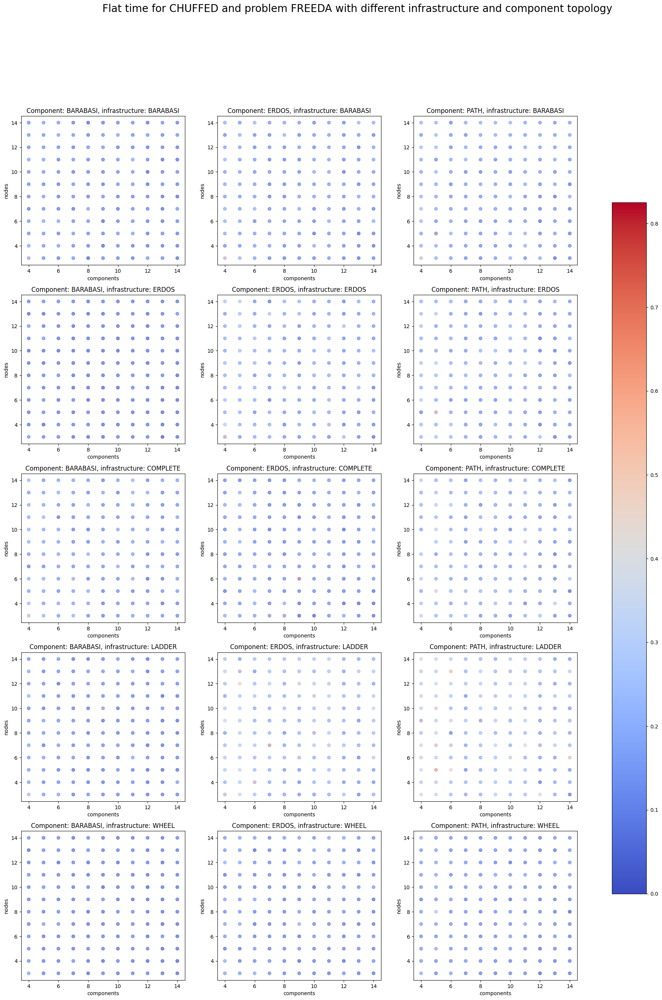

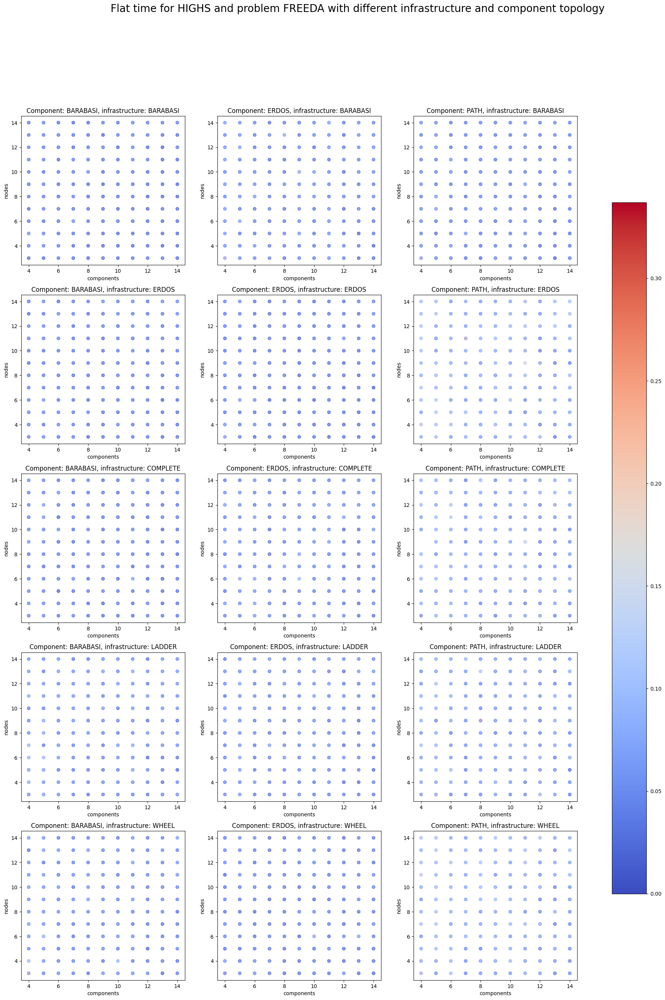

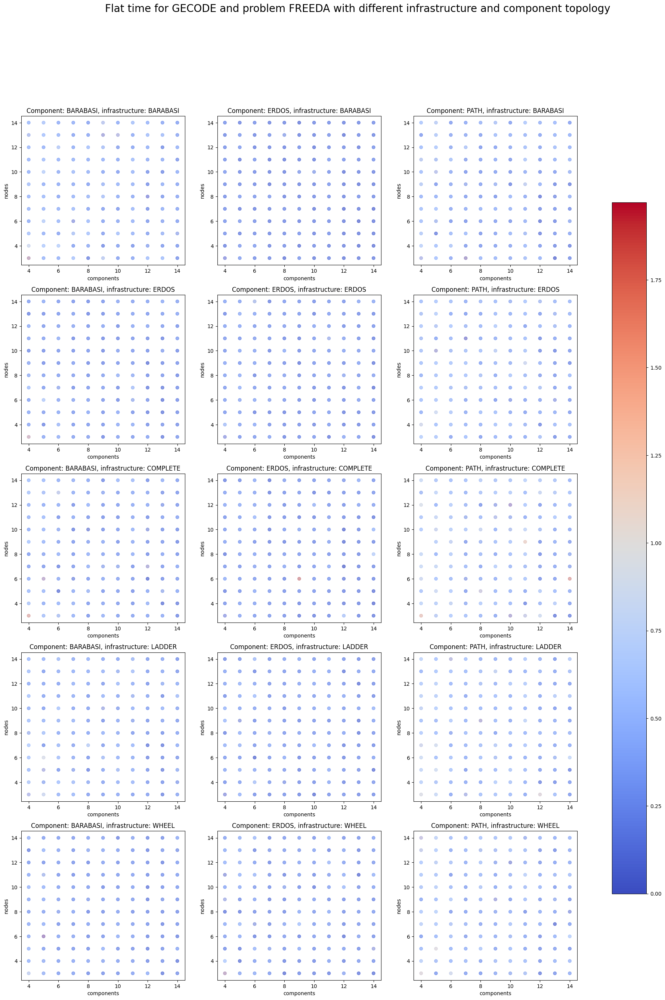

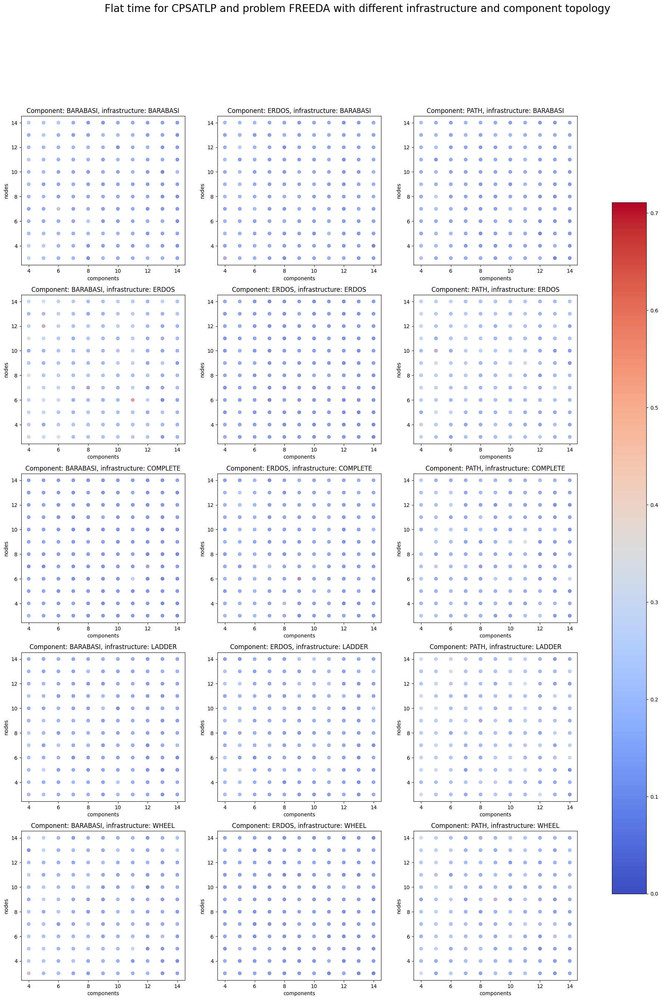

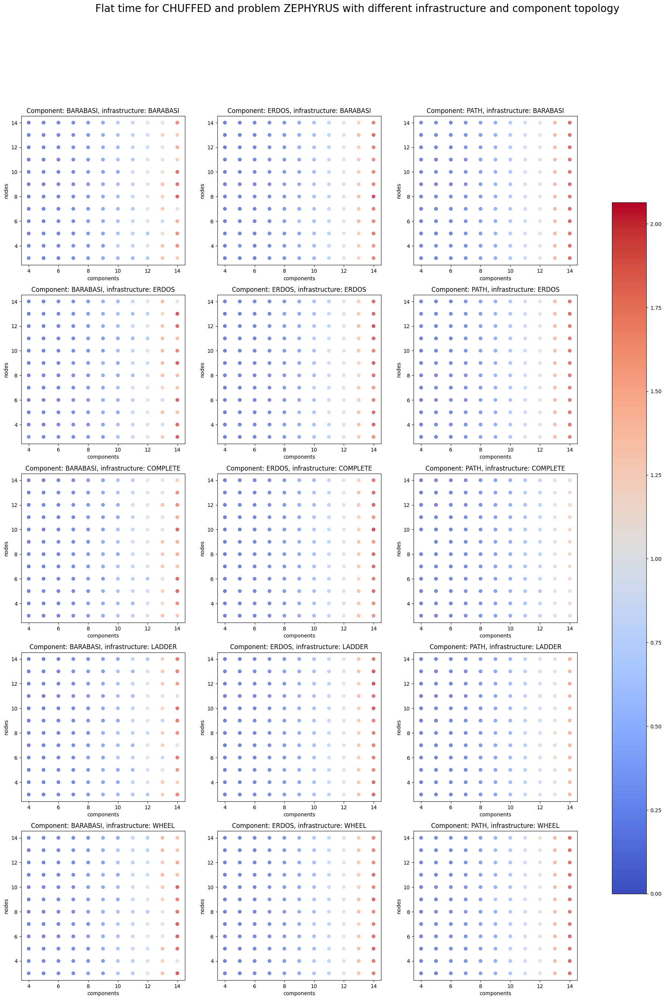

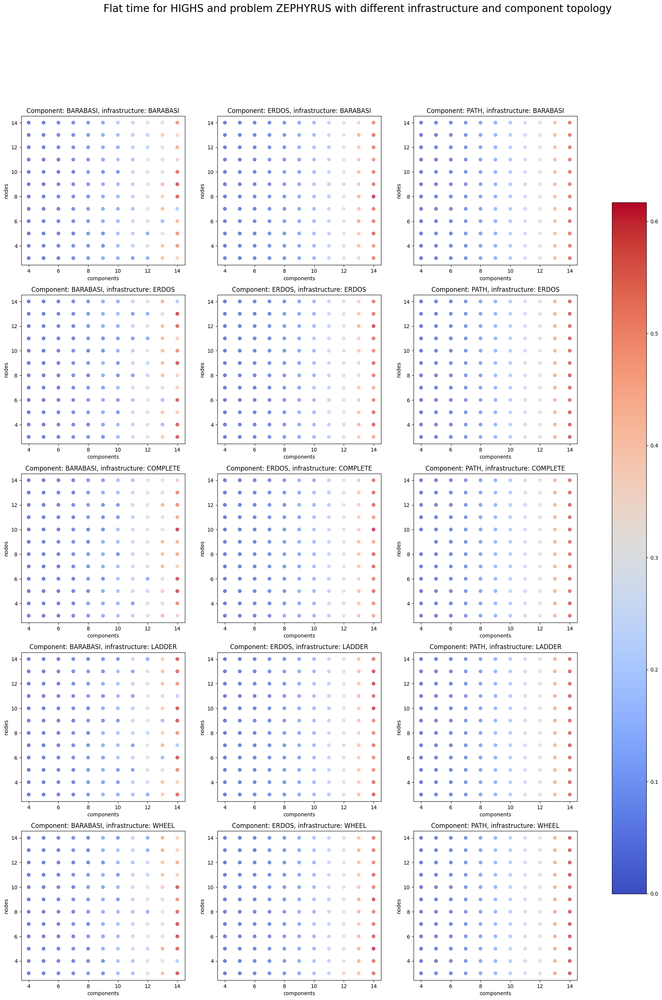

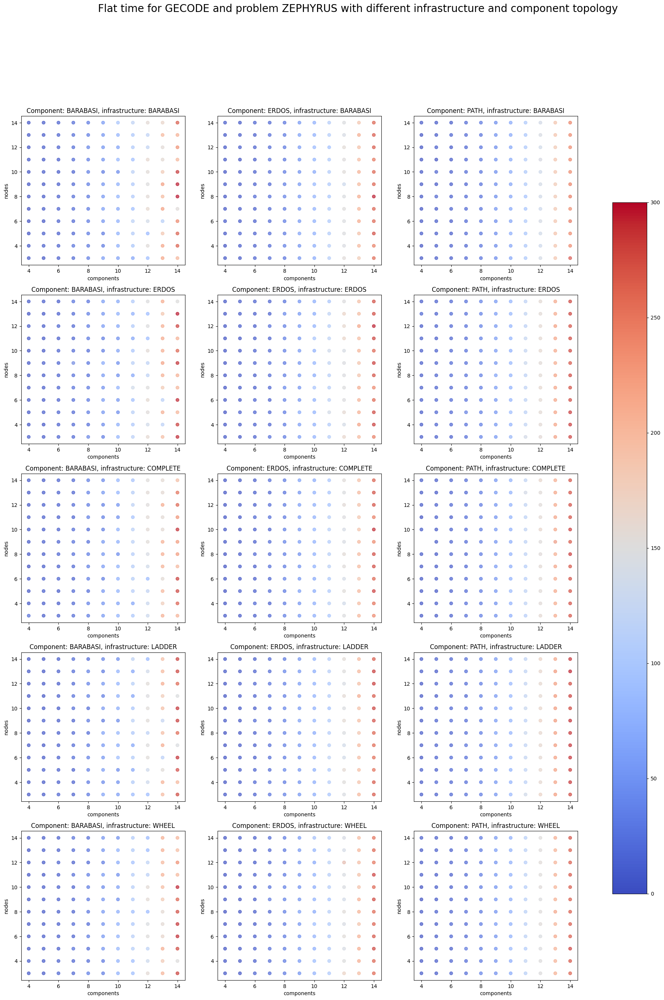

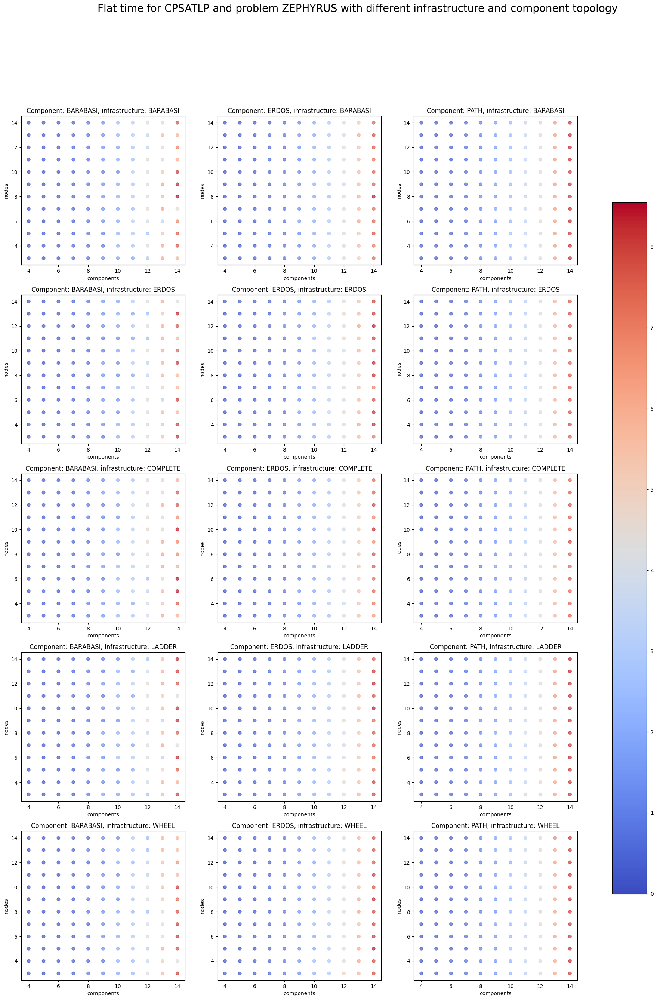

In [187]:
for p in problems:
    for solver in solvers:
        fig, axs = plt.subplots(
            nrows=len(infrastructure_topologies),
            ncols=len(component_topologies),
            figsize=(8 * len(component_topologies), 6 * len(infrastructure_topologies))
        )
        axs_reshaped = axs.reshape(-1)
        axis = itertools.product(infrastructure_topologies, component_topologies)
        df_solver_problem = df.query("problem == @p").query("solver == @solver")
        for (infra_topology, comps_topology), ax in zip(axis, axs_reshaped):
            d = df_solver_problem.query("infra_topology == @infra_topology").query("comps_topology == @comps_topology")
            ax.scatter(
                x=d.components,
                y=d.nodes,
                c=d.flat_time,
                cmap="coolwarm",
                alpha=1.0/len(d.test.unique())
            )
            ax.set_xlabel("components")
            ax.set_ylabel("nodes")
            ax.set_title("Component: " + comps_topology + ", infrastructure: " + infra_topology)

        norm = Normalize(vmin=0, vmax=df_solver_problem.solve_time.max())
        fig.colorbar(
            ScalarMappable(norm=norm, cmap="coolwarm"),
            ax=axs.ravel().tolist(),
            orientation='vertical',
            shrink=0.8
        )
        fig.suptitle("Flat time for " + solver.upper() + " and problem " + p + " with different infrastructure and component topology", fontsize=20)


# Flat time vs Solve time

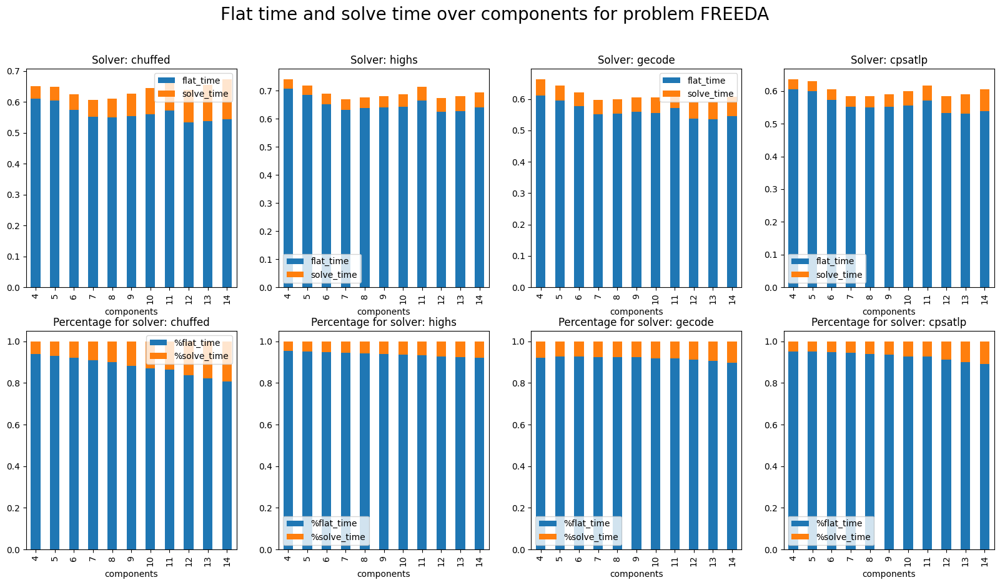

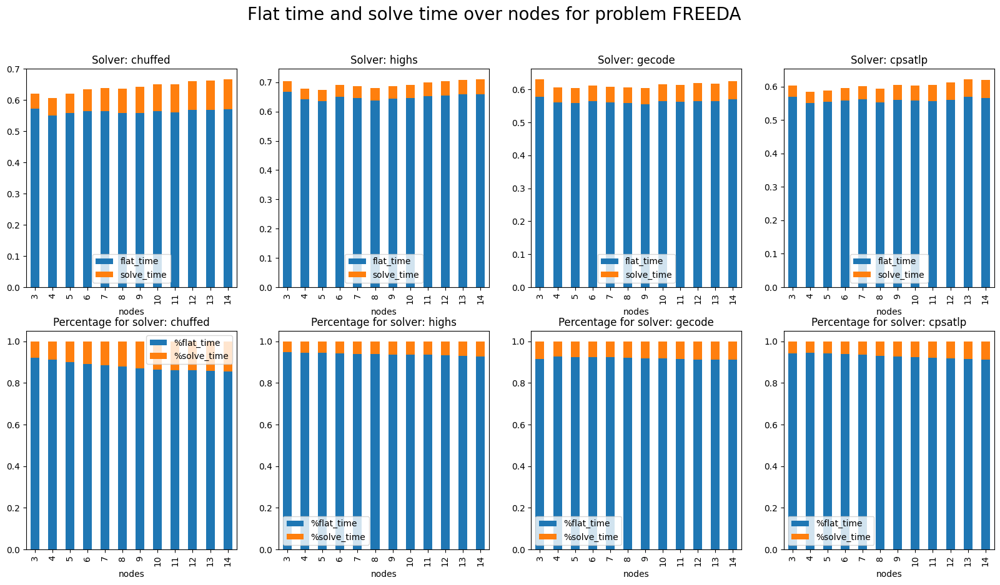

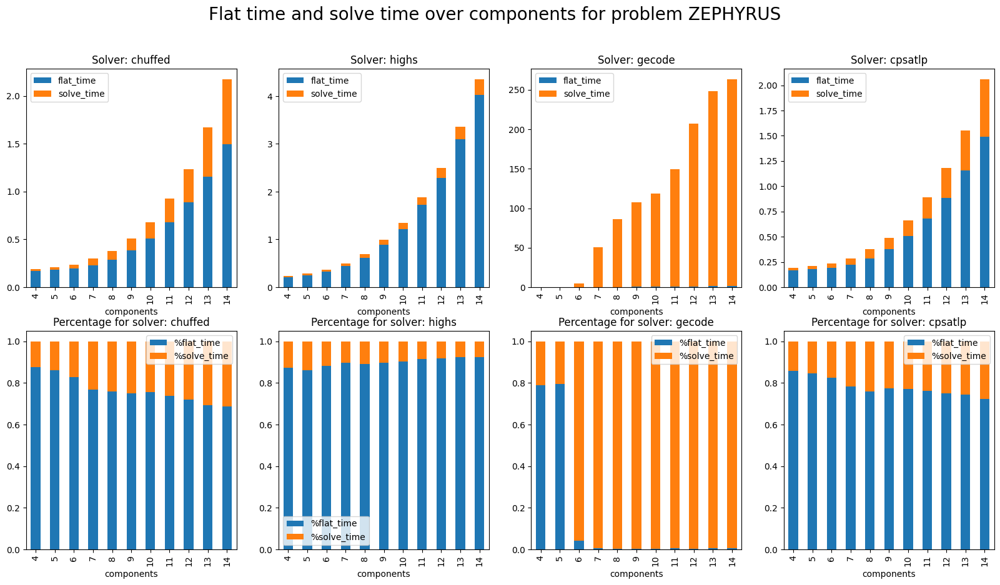

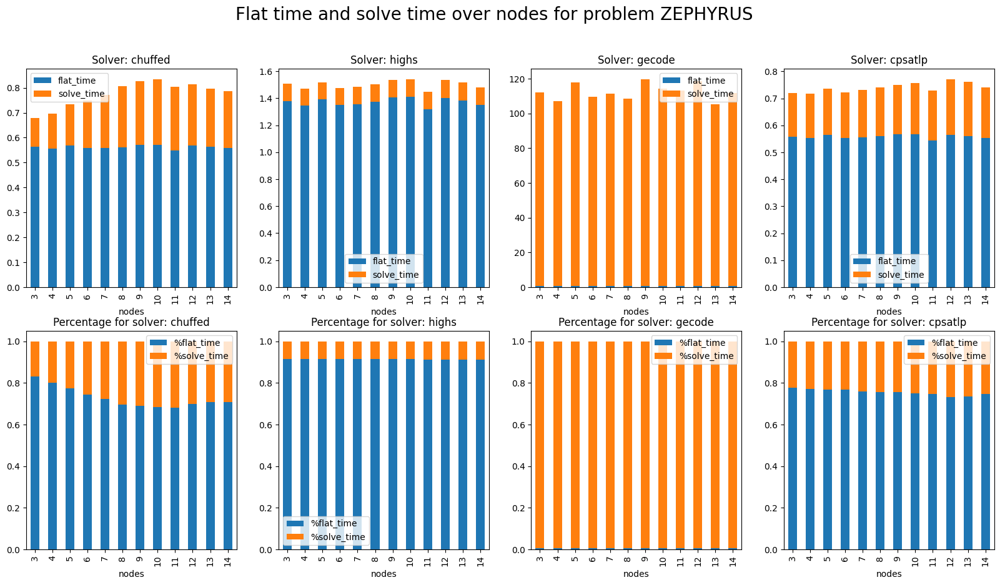

In [49]:
for p in problems:
    for over in ["components", "nodes"]:
        fig, axs = plt.subplots(
            nrows=2,
            ncols=len(solvers),
            figsize=(5 * len(solvers), 10)
        )
        axs_reshaped = axs.reshape(-1)

        for solver, (i, ax) in zip(df.solver.unique(), enumerate(axs_reshaped)):
            times = (
                df.query("solver == @solver")
                    .query("problem == @p")
                    .groupby(over)
                    [["flat_time", "solve_time"]]
                    .mean()
            )

            times.plot.bar(
                ax=ax,
                stacked=True,
                title="Solver: " + solver
            )

            times.assign(**{
                "%flat_time" : lambda df : df["flat_time"] / (df["solve_time"] + df["flat_time"]),
                "%solve_time" : lambda df : df["solve_time"] / (df["solve_time"] + df["flat_time"])
            }).drop(
                columns=["solve_time", "flat_time"]
            ).plot.bar(
                stacked=True,
                title="Percentage for solver: " + solver,
                ax=axs_reshaped[len(solvers) + i],
            )

        fig.suptitle("Flat time and solve time over " + over + " for problem " + p, fontsize=20)
        plt.show()

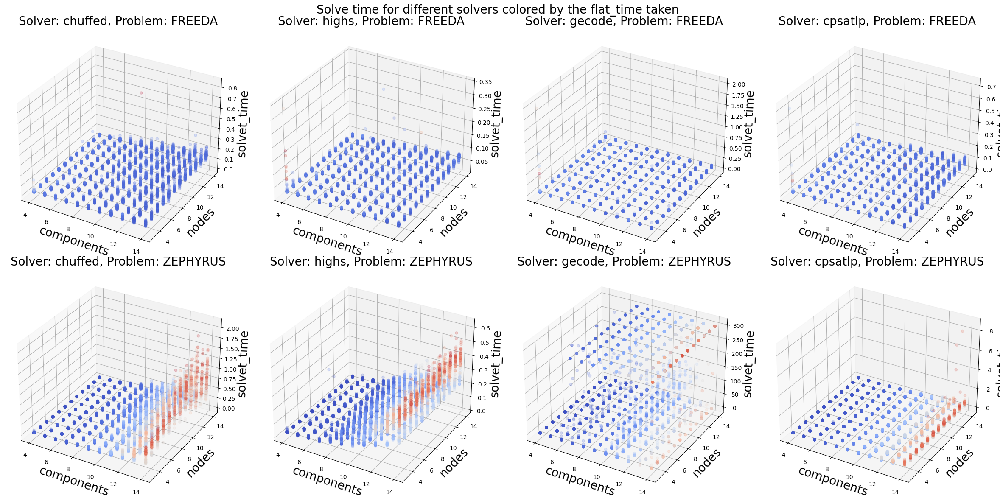

In [35]:
fig, axs = plt.subplots(
    nrows=len(problems),
    ncols=len(solvers),
    figsize=(6 * len(solvers), 6 * len(problems)),
    subplot_kw=dict(projection='3d')
)
for p, ax_row in zip(problems, axs):
    for s, ax in zip(solvers, ax_row):
        d = df.query("problem == @p").query("solver == @s")
        ax.scatter(
            xs=d.components,
            ys=d.nodes,
            zs=d.solve_time,
            c=d.flat_time,
            cmap="coolwarm",
            alpha=1.0/len(d.test.unique())
        )
        ax.set_xlabel("components", fontsize=20)
        ax.set_ylabel("nodes", fontsize=20)
        ax.set_zlabel("solvet_time", fontsize=20)
        ax.set_title("Solver: " + s + ", Problem: " + p, fontsize=20)

fig.suptitle("Solve time for different solvers colored by the flat_time taken", fontsize=20)
fig.tight_layout()

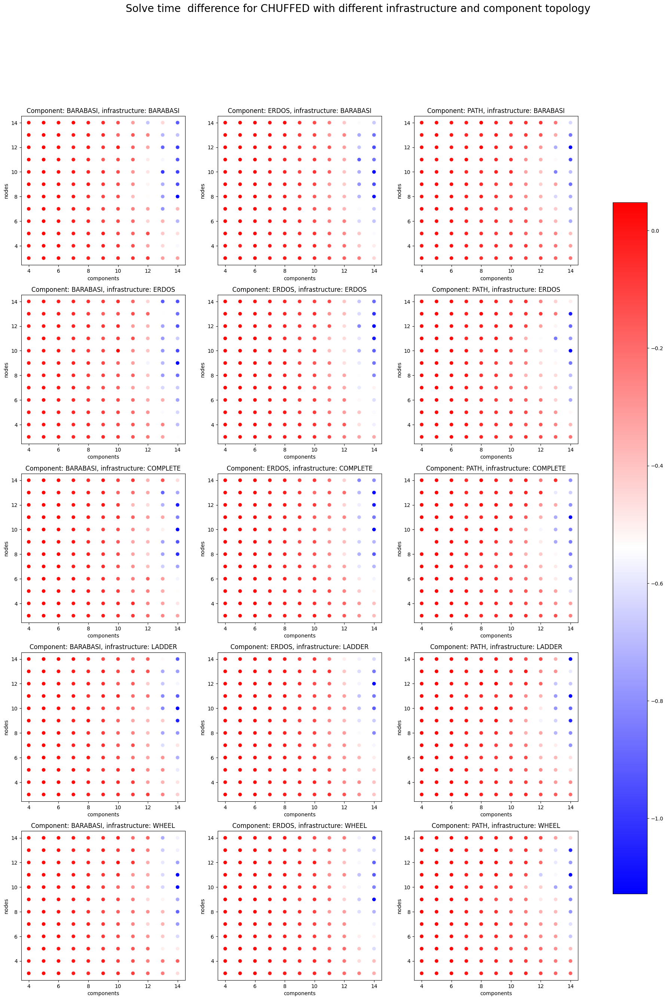

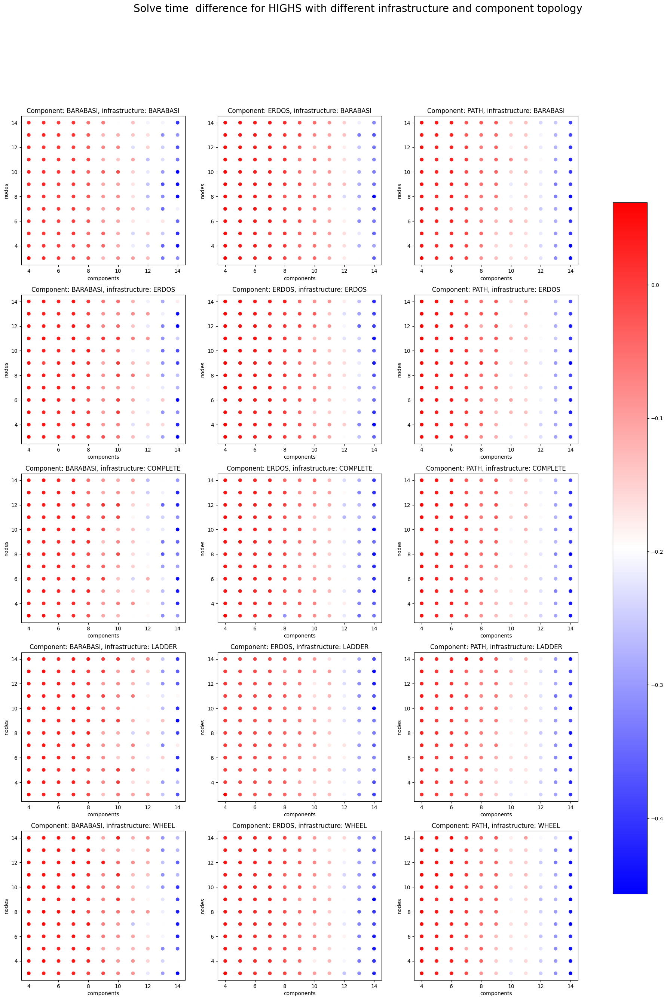

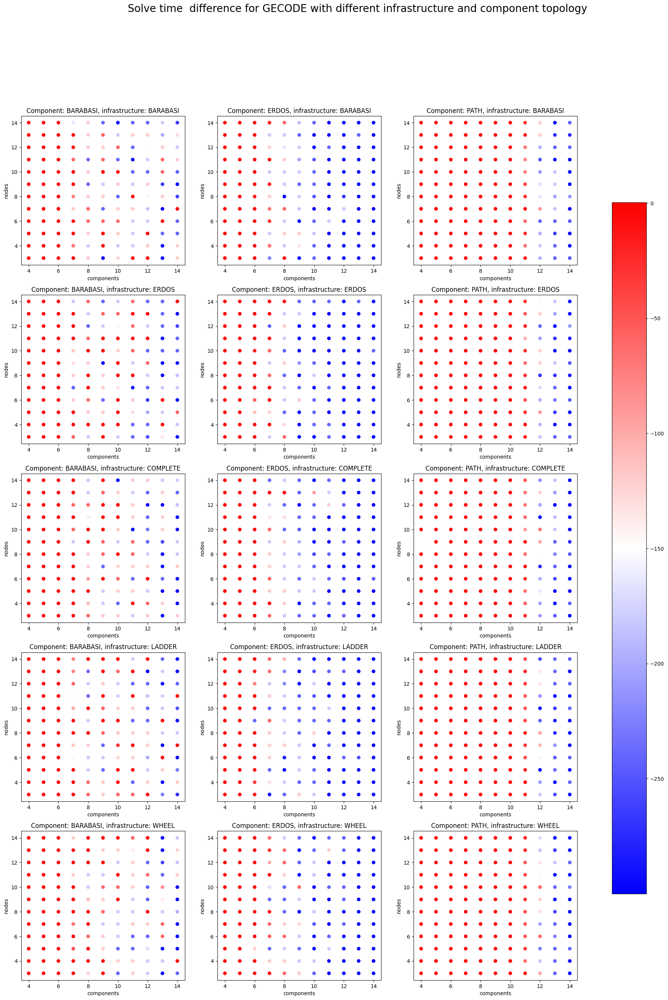

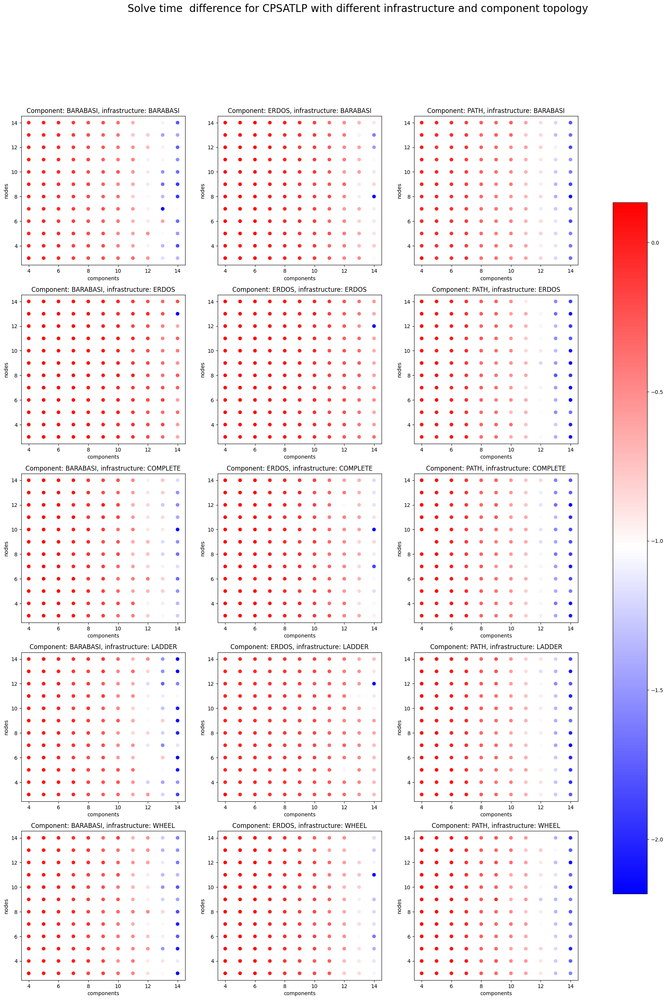

In [37]:
def get_data(df, problem):
    return (
        df.query("problem == @problem")
            .drop(columns=["problem", "flavours", "resources", "status"])
            .groupby(["solver", "components", "nodes", "comps_topology", "infra_topology"])
            .aggregate({"flat_time": "mean", "solve_time": "mean"})
    )

df_diff = (get_data(df, 'FREEDA') - get_data(df, 'ZEPHYRUS')).reset_index()

for solver in solvers:
    fig, axs = plt.subplots(
        nrows=len(infrastructure_topologies),
        ncols=len(component_topologies),
        figsize=(8 * len(component_topologies), 6 * len(infrastructure_topologies))
    )
    axs_reshaped = axs.reshape(-1)
    axis = itertools.product(infrastructure_topologies, component_topologies)
    df_solver = df_diff.query("solver == @solver")
    for (infra_topology, comps_topology), ax in zip(axis, axs_reshaped):
        d = df_solver.query("infra_topology == @infra_topology").query("comps_topology == @comps_topology")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.solve_time,
            cmap="bwr",
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Component: " + comps_topology + ", infrastructure: " + infra_topology)

    norm = Normalize(vmin=df_solver.solve_time.min(), vmax=df_solver.solve_time.max())
    fig.colorbar(
        ScalarMappable(norm=norm, cmap="bwr"),
        ax=axs.ravel().tolist(),
        orientation='vertical',
        shrink=0.8
    )
    fig.suptitle("Solve time difference for " + solver.upper() + " with different infrastructure and component topology", fontsize=20)


# ROSSO DOVE PERDIAMO, BLU DOVE VINCIAMO

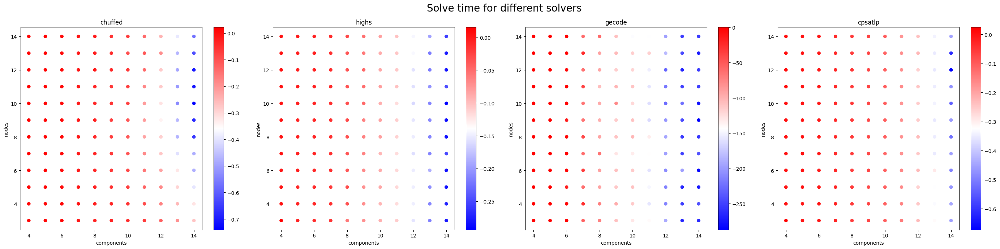

In [47]:
def get_data_2(df, problem):
    return (
        df.query("problem == @problem")
            .drop(columns=["problem", "flavours", "resources", "status"])
            .groupby(["solver", "components", "nodes"])
            .aggregate({"flat_time": "mean", "solve_time": "mean"})
    )

df_diff = (get_data_2(df, 'FREEDA') - get_data_2(df, 'ZEPHYRUS')).reset_index()

fig, axs = plt.subplots(
    nrows=1,
    ncols=len(solvers),
    figsize=(7 * len(solvers), 7)
)
axs_reshaped = axs.reshape(-1)
for solver, ax in zip(solvers, axs_reshaped):
    d = df_diff.query("solver == @solver")
    norm = Normalize(vmin=d.solve_time.min(), vmax=d.solve_time.max())
    ax.scatter(
        x=d.components,
        y=d.nodes,
        c=d.solve_time,
        cmap="bwr"
    )
    ax.set_xlabel("components")
    ax.set_ylabel("nodes")
    ax.set_title(solver)
    fig.colorbar(ScalarMappable(norm=norm, cmap="bwr"), ax=ax, orientation='vertical')

fig.suptitle("Solve time for different solvers", fontsize=20)
fig.tight_layout()
# ROSSO DOVE PERDIAMO, BLU DOVE VINCIAMO